In [154]:
import omicverse as ov
import scanpy as sc
import pandas as pd
import random
from matplotlib.backends.backend_pdf import PdfPages
import os

project_directory = '/Cranio_Lab/Louk_Seton/mesenchyme_project_2023'
os.chdir(os.path.expanduser("~")+project_directory)

In [110]:
#adata = sc.read('anndata_objects/adata_all_cells.h5ad')
adata = sc.read('anndata_objects/adata_all_aucell.h5ad')

In [111]:
adata.obs['stage'] = adata.obs['stage'].cat.reorder_categories(['8','9','10','11','12','13','14'], ordered=True)
#adata = adata[adata.obs['stage'].isin(['11','12','13','14'])].copy()

In [4]:
adata

AnnData object with n_obs × n_vars = 58973 × 21619
    obs: 'Clusters', '_X', '_Y', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'sample', 'barcode', 'batch', 'doublet_score', 'predicted_doublets', 'predicted_doublets_based_on_10x_chromium_spec', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'pct_counts_unspliced', 'pred_doubl_cat', 'stage', 'S_score', 'G2M_score', 'phase', 'topic_0', 'topic_1', 'topic_2', 'topic_3', 'topic_4', 'topic_5', 'topic_6', 'topic_7', 'topic_8', 'topic_9', 'leiden', 'annotation_all', 'EFO_0007841_aucell', 'random_1_aucell', 'EFO_0007841 - facial morphology measurement(GWAS)_aucell', 'EFO_0007843 - nose morphology measurement(GWAS)_aucell', 'EFO_1000720 - keratosis_aucell', 'EFO_0005917 - generalised epilepsy_aucell', 'EFO_0005410 - tooth agenesis_aucell', 'EFO_0000540 - immune system disease_aucell', 'MONDO_0019548 - autosomal dominant intermediate Charcot-Marie-Tooth disease_a

In [50]:
# gene_set_dict = {}
# for disease in disease_dict:
#     facial_morphology_genes_df = pd.read_csv('GWAS/gwas_csv/'+disease+'_genes_df.csv',index_col=False)
#     facial_morphology_genes_df = facial_morphology_genes_df[facial_morphology_genes_df['targetId'].isin(list(adata.var.index))]
#     gene_set_dict[disease + ' - ' + disease_dict[disease]] = list(set(facial_morphology_genes_df['targetId']))
#     #gene_set_dict[disease + ' - ' + disease_dict[disease]] = list(set(facial_morphology_genes_df['targetId']) & set(list(adata.var[adata.var['highly_variable']==True]['gene_name'])))
    
# gene_set_dict['random_1'] = random.sample(list(adata.var['gene_name']), 200)
# gene_set_dict['random_2'] = random.sample(list(adata.var['gene_name']), 200)
# gene_set_dict.keys()


dict_keys(['EFO_0007841 - facial morphology measurement(GWAS)', 'EFO_0007843 - nose morphology measurement(GWAS)', 'EFO_1000720 - keratosis', 'EFO_0005917 - generalised epilepsy', 'EFO_0005410 - tooth agenesis', 'EFO_0000540 - immune system disease', 'MONDO_0019548 - autosomal dominant intermediate Charcot-Marie-Tooth disease', 'EFO_0010642 - neurodevelopmental disorder', 'EFO_0004875 - mathematical ability', 'random_1', 'random_2'])

In [106]:
disease_dict = {
    'EFO_0007841_0.1':'facial morphology measurement(GWAS)',
    'EFO_1000720': 'keratosis',
    'EFO_0005917': 'generalised epilepsy',
    'EFO_0000540':'immune system disease',
    'MONDO_0019548':'autosomal dominant intermediate Charcot-Marie-Tooth disease',
}

xls_df = {}

for disease in disease_dict:
    xls_df[disease] = pd.read_csv('GWAS/gwas_csv/'+disease+'_genes_df.csv',index_col=False)
    xls_df[disease] = xls_df[disease][xls_df[disease]['targetId'].isin(list(adata.var[adata.var['highly_variable']==True]['gene_name']))]

gene_list_org = pd.read_excel('GWAS/disgenet/DISEASES_Evidence_GDA_CURATED_C0158646-C0008924-C0008925-C0685787-C1850256-C1844537-C4759655-C0376634-C4023011-C2931196-C0221356-C0266617-C3665865-Evidence all.xlsx')
gene_list = gene_list_org

gene_list = list(set(gene_list['gene_ensembl']))

ortholog_map = 'GWAS/ensembl_human_orthologues/Human_to_Mouse.txt'

print('mapping using specified orthologue file')
ortholog_map_df = pd.read_csv(ortholog_map)
ortholog_map_df = ortholog_map_df.dropna()
input_gene_count = len(gene_list)
ortholog_map_dict = dict(zip(ortholog_map_df.iloc[:,0], ortholog_map_df.iloc[:,3]))
gene_list = [x for x in map(ortholog_map_dict.get, gene_list) if x is not None]
print(len(gene_list), 'focal species genes mapped to', input_gene_count, 'human genes.')

gene_list_org = gene_list_org[gene_list_org['gene_ensembl'].isin(list(ortholog_map_dict.keys()))]

gene_list_org = gene_list_org[['gene_ensembl','gene_symbol','numVariantsAssociatedToGene','disease_name','pmid',]]
gene_list_org.set_index('gene_ensembl',inplace=True)
gene_list_org = gene_list_org.merge(pd.DataFrame.from_dict(ortholog_map_dict,orient = 'index'), left_index=True, right_index=True)
gene_list_org.rename(columns = {0:'mouse_gene'}, inplace = True)
gene_list_org['geneEnsemblIDs'] = list(gene_list_org.index)
gene_list_org = gene_list_org[gene_list_org['mouse_gene'].isin(list(adata.var[adata.var['highly_variable']==True]['gene_name']))]

gene_list_org.set_index('mouse_gene',inplace= True)

xls_df['disgenet'] = gene_list_org

import json
with open('MP_ontology_db/mp.json') as Mammalian_phenotypes_json: ##load phenotype json
  Mammalian_phenotypes = json.load(Mammalian_phenotypes_json)
    
Mammalian_phenotypes_df = pd.DataFrame(Mammalian_phenotypes['graphs'][0]['edges']) ##get phenotype edges
Mammalian_phenotypes_df = Mammalian_phenotypes_df[Mammalian_phenotypes_df["sub"].str.contains("MP_")] #keep only MP
Mammalian_phenotypes_df = Mammalian_phenotypes_df.iloc[:,[0,2]] #remove columns
Mammalian_phenotypes_df['sub'] = Mammalian_phenotypes_df['sub'].str.split('/').str[-1] #URL to MP
Mammalian_phenotypes_df['obj'] = Mammalian_phenotypes_df['obj'].str.split('/').str[-1]
Mammalian_phenotypes_df.replace('_', ':', regex=True, inplace = True) #replace underscore by :
Mammalian_phenotypes_df.set_index('sub',inplace = True) #Set subject MP to index

##Load in MGI gene model, this is to match genes to MGI ids
MGI_Gene_Model_Coord = pd.read_csv('MP_ontology_db/MGI_Gene_Model_Coord.rpt',skiprows=[0], sep="\t",
                  names = ['MGI Marker Accession ID','Marker Type','Marker Symbol','Marker Name','Genome Build','Entrez Gene ID','NCBI Gene Chromosome','NCBI Gene Start','NCBI Gene End','NCBI Gene Strand','Ensembl Gene ID','Ensembl Gene Chromosome','Ensembl Gene Start','Ensembl Gene End','Ensembl Gene Strand','empty']
                  )
MGI_Gene_Model_Coord = MGI_Gene_Model_Coord.iloc[:,range(0,15)]
MGI_Gene_Model_Coord.set_index('MGI Marker Accession ID',inplace = True)

##Load in ontology information
MGI_PhenoGenoMP = pd.read_csv('MP_ontology_db/MGI_PhenoGenoMP.rpt', sep="\t",
                  names = ['Allelic Composition','Allele Symbols (pipe-delimited)','Genetic Background',
                           'Mammalian Phenotype ID','PubMed IDs (pipe-delimited)','MGI Marker Accession ID']
                  )

MGI_PhenoGenoMP['MGI Marker Accession ID'] = MGI_PhenoGenoMP['MGI Marker Accession ID'].str.split('|') #split multiple MGI IDs in column by pipe
MGI_PhenoGenoMP = MGI_PhenoGenoMP.explode('MGI Marker Accession ID') #Explode MGI IDs into new rows
MGI_PhenoGenoMP.set_index('MGI Marker Accession ID',inplace = True)
MGI_PhenoGenoMP = pd.merge(MGI_Gene_Model_Coord['Marker Symbol'], MGI_PhenoGenoMP, how='right', left_index = True, right_index = True) #Make row with gene names based on matching MGI IDs
MGI_PhenoGenoMP = MGI_PhenoGenoMP.drop_duplicates( #Remove duplicate gene-phenotype rows
    subset = ['Marker Symbol', 'Mammalian Phenotype ID'],
    keep = 'first')
MGI_PhenoGenoMP.dropna(subset=["Marker Symbol"],inplace=True) #remove rows without gene names
MGI_PhenoGenoMP = MGI_PhenoGenoMP.iloc[:,[0,4]] #keep relevant columns

disease_dict = {
    'MP:0009901':'abnormal frontonasal prominence morphology',
    'MP:0009902':'abnormal lateral nasal prominence morphology',
    'MP:0010940':'abnormal maxillary prominence morphology',   
    'MP:0009903':'abnormal medial nasal prominence morphology',
}
combined_MP = []
for disease in disease_dict:
    query_MP = disease

    query = [query_MP]
    result_MP = [query_MP]

    ##Use a while loop to find all phenotype descendants
    while query:
        query = list(Mammalian_phenotypes_df[Mammalian_phenotypes_df.obj.isin(query)].index)
        result_MP = result_MP + query
    combined_MP = combined_MP+result_MP

MGI_PhenoGenoMP_sub  = MGI_PhenoGenoMP[MGI_PhenoGenoMP['Mammalian Phenotype ID'].isin(combined_MP)]
MGI_PhenoGenoMP_sub = MGI_PhenoGenoMP_sub[MGI_PhenoGenoMP_sub['Marker Symbol'].isin(list(adata.var[adata.var['highly_variable']==True]['gene_name']))]

xls_df['MGI_prominences'] = MGI_PhenoGenoMP_sub

mapping using specified orthologue file
210 focal species genes mapped to 214 human genes.


In [108]:
with pd.ExcelWriter("Supplementary Table 4 - Genes used for AUCell analysis.xlsx") as writer:
    for df_name, df in xls_df.items():
        df.to_excel(writer, sheet_name=df_name)

In [113]:
disease_dict = {
    'EFO_0007841_0.1':'facial morphology measurement(GWAS)',
    'EFO_1000720': 'keratosis',
    'EFO_0005917': 'generalised epilepsy',
    'EFO_0000540':'immune system disease',
    'MONDO_0019548':'autosomal dominant intermediate Charcot-Marie-Tooth disease',
}

In [114]:
gene_set_dict = {}
for disease in disease_dict:
    facial_morphology_genes_df = pd.read_csv('GWAS/gwas_csv/'+disease+'_genes_df.csv',index_col=False)
    facial_morphology_genes_df = facial_morphology_genes_df[facial_morphology_genes_df['targetId'].isin(list(adata.var.index))]
   # gene_set_dict[disease + ' - ' + disease_dict[disease]] = list(set(facial_morphology_genes_df['targetId']))
    gene_set_dict[disease + ' - ' + disease_dict[disease]] = list(set(facial_morphology_genes_df['targetId']) & set(list(adata.var[adata.var['highly_variable']==True]['gene_name'])))
    
#gene_set_dict['random_1'] = random.sample(list(adata.var[adata.var['highly_variable']==True]['gene_name']),200)
#gene_set_dict['random_2'] = random.sample(list(adata.var['gene_name']), 200)
gene_set_dict.keys()

dict_keys(['EFO_0007841_0.1 - facial morphology measurement(GWAS)', 'EFO_1000720 - keratosis', 'EFO_0005917 - generalised epilepsy', 'EFO_0000540 - immune system disease', 'MONDO_0019548 - autosomal dominant intermediate Charcot-Marie-Tooth disease'])

In [115]:
gene_list = pd.read_excel('GWAS/disgenet/DISEASES_Evidence_GDA_CURATED_C0376634.xlsx')
gene_list = list(set(gene_list['geneEnsemblIDs']))

In [116]:
ortholog_map = 'GWAS/ensembl_human_orthologues/Human_to_Mouse.txt'

print('mapping using specified orthologue file')
ortholog_map_df = pd.read_csv(ortholog_map)
ortholog_map_df = ortholog_map_df.dropna()
input_gene_count = len(gene_list)
ortholog_map_dict = dict(zip(ortholog_map_df.iloc[:,0], ortholog_map_df.iloc[:,3]))
gene_list = [x for x in map(ortholog_map_dict.get, gene_list) if x is not None]
print(len(gene_list), 'focal species genes mapped to', input_gene_count, 'human genes.')

mapping using specified orthologue file
150 focal species genes mapped to 153 human genes.


In [117]:
gene_set_dict['disgenet'] = list(set(gene_list) & set(list(adata.var[adata.var['highly_variable']==True]['gene_name'])))

In [118]:
gene_list = pd.read_excel('GWAS/disgenet/DISEASES_Evidence_GDA_CURATED_C0158646-C0008924-C0008925-C0685787-C1850256-C1844537-C4759655-C0376634-C4023011-C2931196-C0221356-C0266617-C3665865-Evidence all.xlsx')
gene_list = list(set(gene_list['gene_ensembl']))
len(gene_list)

214

In [119]:
ortholog_map = 'GWAS/ensembl_human_orthologues/Human_to_Mouse.txt'

print('mapping using specified orthologue file')
ortholog_map_df = pd.read_csv(ortholog_map)
ortholog_map_df = ortholog_map_df.dropna()
input_gene_count = len(gene_list)
ortholog_map_dict = dict(zip(ortholog_map_df.iloc[:,0], ortholog_map_df.iloc[:,3]))
gene_list = [x for x in map(ortholog_map_dict.get, gene_list) if x is not None]
print(len(gene_list), 'focal species genes mapped to', input_gene_count, 'human genes.')

mapping using specified orthologue file
210 focal species genes mapped to 214 human genes.


In [120]:
gene_set_dict['disgenet_cleft'] = list(set(gene_list) & set(list(adata.var[adata.var['highly_variable']==True]['gene_name'])))

In [121]:
import json
with open('MP_ontology_db/mp.json') as Mammalian_phenotypes_json: ##load phenotype json
  Mammalian_phenotypes = json.load(Mammalian_phenotypes_json)
    
Mammalian_phenotypes_df = pd.DataFrame(Mammalian_phenotypes['graphs'][0]['edges']) ##get phenotype edges
Mammalian_phenotypes_df = Mammalian_phenotypes_df[Mammalian_phenotypes_df["sub"].str.contains("MP_")] #keep only MP
Mammalian_phenotypes_df = Mammalian_phenotypes_df.iloc[:,[0,2]] #remove columns
Mammalian_phenotypes_df['sub'] = Mammalian_phenotypes_df['sub'].str.split('/').str[-1] #URL to MP
Mammalian_phenotypes_df['obj'] = Mammalian_phenotypes_df['obj'].str.split('/').str[-1]
Mammalian_phenotypes_df.replace('_', ':', regex=True, inplace = True) #replace underscore by :
Mammalian_phenotypes_df.set_index('sub',inplace = True) #Set subject MP to index

In [122]:
##Load in MGI gene model, this is to match genes to MGI ids
MGI_Gene_Model_Coord = pd.read_csv('MP_ontology_db/MGI_Gene_Model_Coord.rpt',skiprows=[0], sep="\t",
                  names = ['MGI Marker Accession ID','Marker Type','Marker Symbol','Marker Name','Genome Build','Entrez Gene ID','NCBI Gene Chromosome','NCBI Gene Start','NCBI Gene End','NCBI Gene Strand','Ensembl Gene ID','Ensembl Gene Chromosome','Ensembl Gene Start','Ensembl Gene End','Ensembl Gene Strand','empty']
                  )
MGI_Gene_Model_Coord = MGI_Gene_Model_Coord.iloc[:,range(0,15)]
MGI_Gene_Model_Coord.set_index('MGI Marker Accession ID',inplace = True)

##Load in ontology information
MGI_PhenoGenoMP = pd.read_csv('MP_ontology_db/MGI_PhenoGenoMP.rpt', sep="\t",
                  names = ['Allelic Composition','Allele Symbols (pipe-delimited)','Genetic Background',
                           'Mammalian Phenotype ID','PubMed IDs (pipe-delimited)','MGI Marker Accession ID']
                  )

MGI_PhenoGenoMP['MGI Marker Accession ID'] = MGI_PhenoGenoMP['MGI Marker Accession ID'].str.split('|') #split multiple MGI IDs in column by pipe
MGI_PhenoGenoMP = MGI_PhenoGenoMP.explode('MGI Marker Accession ID') #Explode MGI IDs into new rows
MGI_PhenoGenoMP.set_index('MGI Marker Accession ID',inplace = True)
MGI_PhenoGenoMP = pd.merge(MGI_Gene_Model_Coord['Marker Symbol'], MGI_PhenoGenoMP, how='right', left_index = True, right_index = True) #Make row with gene names based on matching MGI IDs
MGI_PhenoGenoMP = MGI_PhenoGenoMP.drop_duplicates( #Remove duplicate gene-phenotype rows
    subset = ['Marker Symbol', 'Mammalian Phenotype ID'],
    keep = 'first')
MGI_PhenoGenoMP.dropna(subset=["Marker Symbol"],inplace=True) #remove rows without gene names
MGI_PhenoGenoMP = MGI_PhenoGenoMP.iloc[:,[0,4]] #keep relevant columns
MGI_PhenoGenoMP

,Marker Symbol,Mammalian Phenotype ID
MGI Marker Accession ID,,
MGI:97874,Rb1,MP:0000600
MGI:97874,Rb1,MP:0001716
MGI:97874,Rb1,MP:0001698
MGI:97874,Rb1,MP:0001092
MGI:97874,Rb1,MP:0000961
...,...,...
MGI:1921160,Arhgap18,MP:0009871
MGI:1921160,Arhgap18,MP:0009873
MGI:1921160,Arhgap18,MP:0020849


In [123]:
disease_dict = {
    'MP:0002233':'abnormal nose morphology',
    'MP:0003935':'abnormal craniofacial development',
    'MP:0003743':'abnormal facial morphology',
    'MP:0011495': 'abnormal head shape',
    'MP:0021164':'oral cleft',
    'MP:0009901':'abnormal frontonasal prominence morphology',
    'MP:0009902':'abnormal lateral nasal prominence morphology',
    'MP:0010940':'abnormal maxillary prominence morphology',   
    'MP:0009903':'abnormal medial nasal prominence morphology',
}

In [124]:
for disease in disease_dict:
    query_MP = disease

    query = [query_MP]
    result_MP = [query_MP]

    ##Use a while loop to find all phenotype descendants
    while query:
        query = list(Mammalian_phenotypes_df[Mammalian_phenotypes_df.obj.isin(query)].index)
        result_MP = result_MP + query
    
    MGI_PhenoGenoMP_sub = MGI_PhenoGenoMP[MGI_PhenoGenoMP['Mammalian Phenotype ID'].isin(result_MP)].drop_duplicates( #Remove duplicate gene rows
        subset = ['Marker Symbol',],
        keep = 'first')
    #gene_set_dict[disease + ' - ' + disease_dict[disease]] = list(MGI_PhenoGenoMP_sub['Marker Symbol'])
    ###Since there seems to be a lot of noise, here I am checking what happens if I only keep the intersect of highly variable genes and mgi genes
    gene_set_dict[disease + ' - ' + disease_dict[disease]] = list(set(list(MGI_PhenoGenoMP_sub['Marker Symbol'])) & set(list(adata.var[adata.var['highly_variable']==True]['gene_name'])))

gene_set_dict['prominences'] = list(set(gene_set_dict['MP:0009901 - abnormal frontonasal prominence morphology']+gene_set_dict['MP:0009902 - abnormal lateral nasal prominence morphology']+gene_set_dict['MP:0010940 - abnormal maxillary prominence morphology']+gene_set_dict['MP:0009903 - abnormal medial nasal prominence morphology']))
    
gene_set_dict.keys()

dict_keys(['EFO_0007841_0.1 - facial morphology measurement(GWAS)', 'EFO_1000720 - keratosis', 'EFO_0005917 - generalised epilepsy', 'EFO_0000540 - immune system disease', 'MONDO_0019548 - autosomal dominant intermediate Charcot-Marie-Tooth disease', 'disgenet', 'disgenet_cleft', 'MP:0002233 - abnormal nose morphology', 'MP:0003935 - abnormal craniofacial development', 'MP:0003743 - abnormal facial morphology', 'MP:0011495 - abnormal head shape', 'MP:0021164 - oral cleft', 'MP:0009901 - abnormal frontonasal prominence morphology', 'MP:0009902 - abnormal lateral nasal prominence morphology', 'MP:0010940 - abnormal maxillary prominence morphology', 'MP:0009903 - abnormal medial nasal prominence morphology', 'prominences'])

ctxcore have been install version: 0.2.0


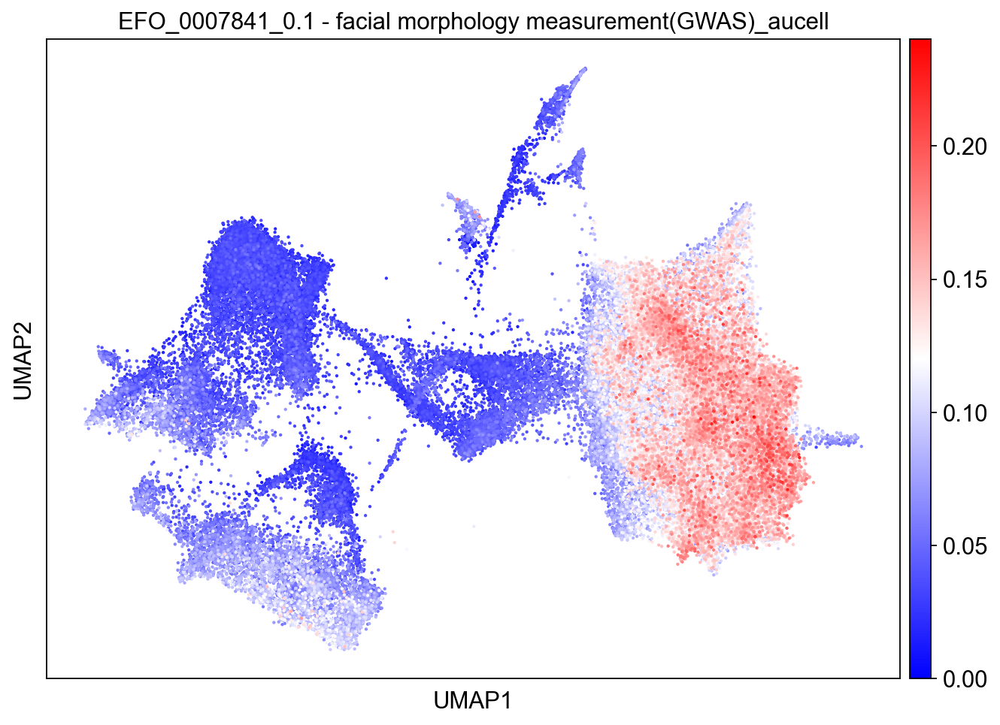

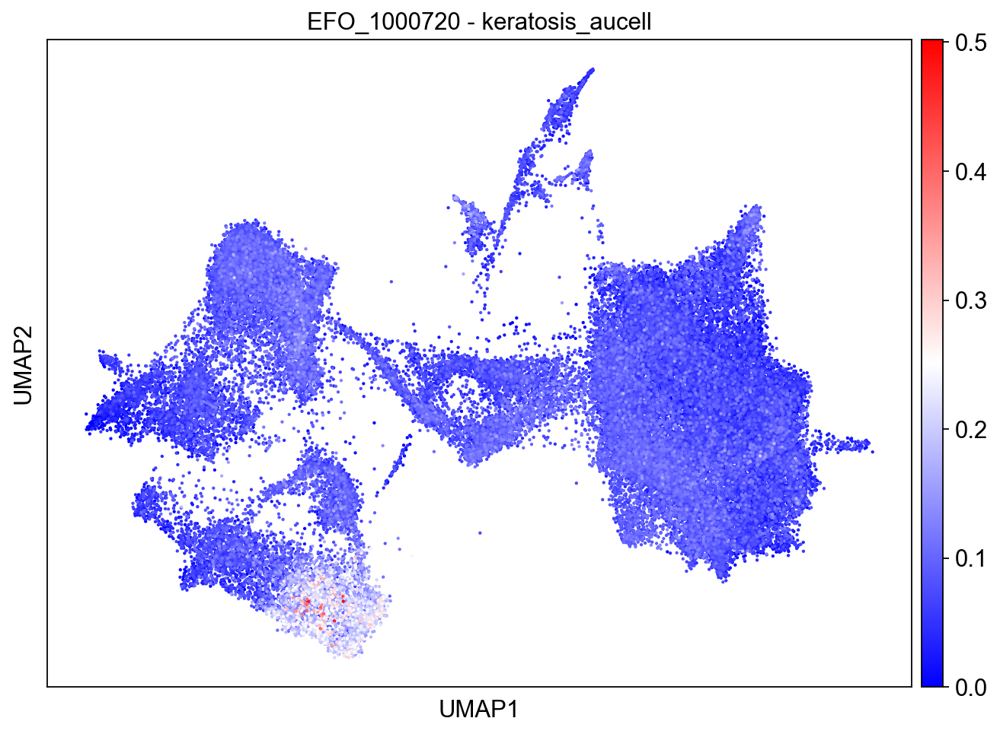

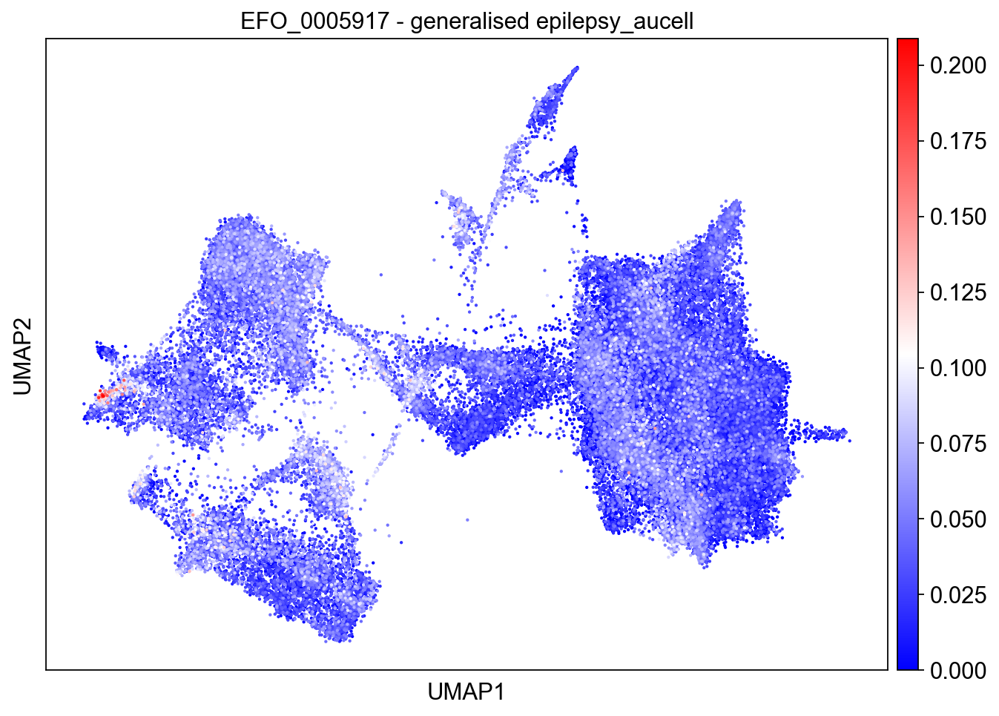

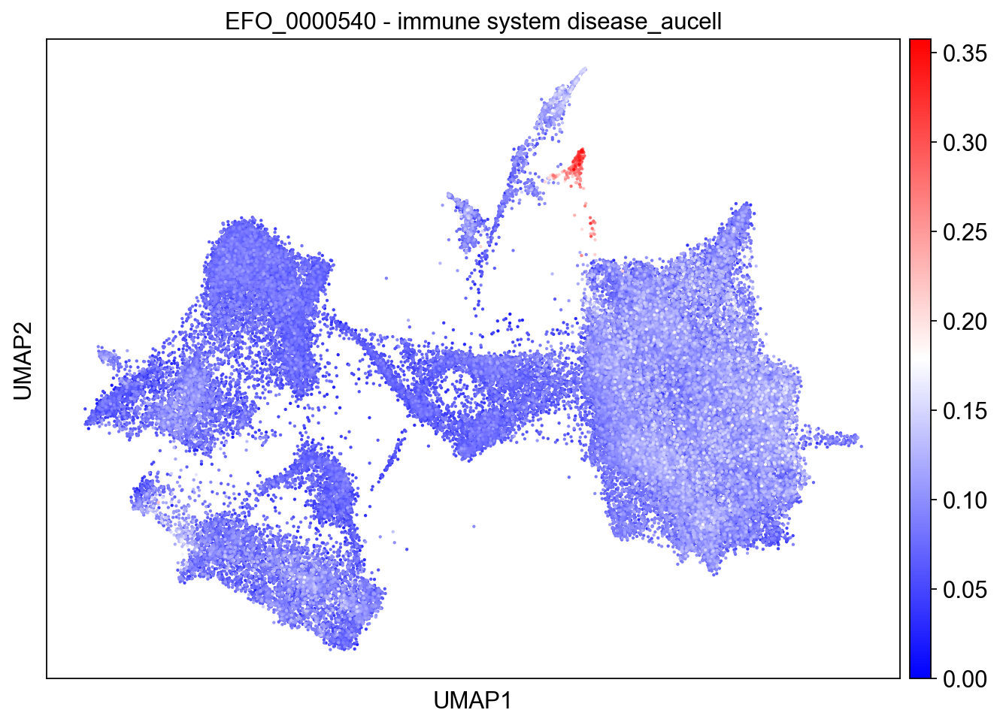

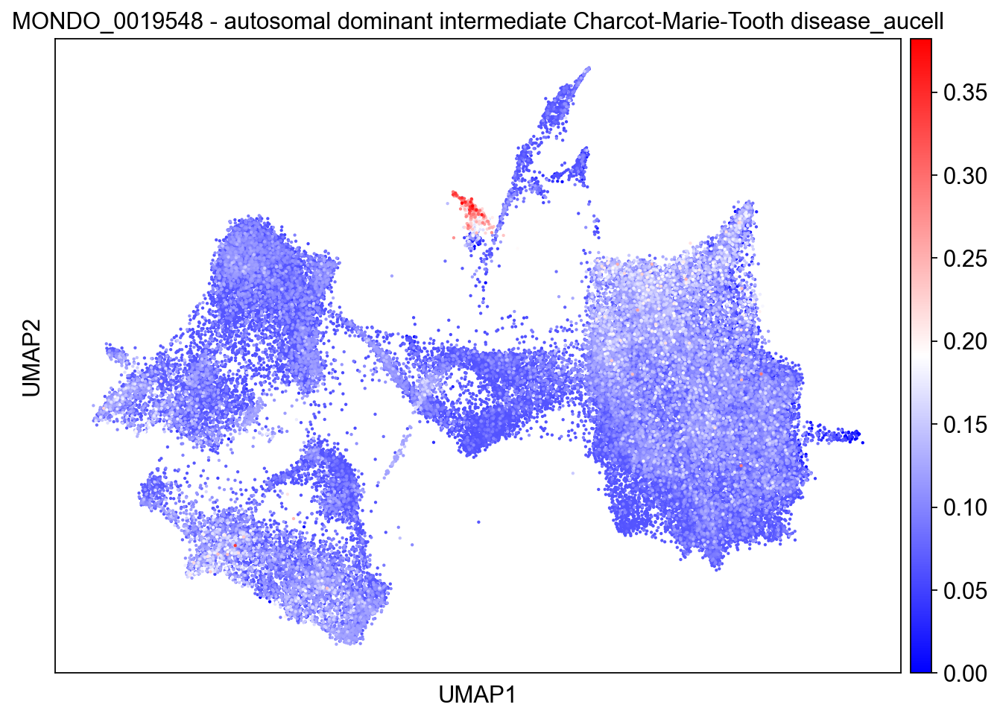

...

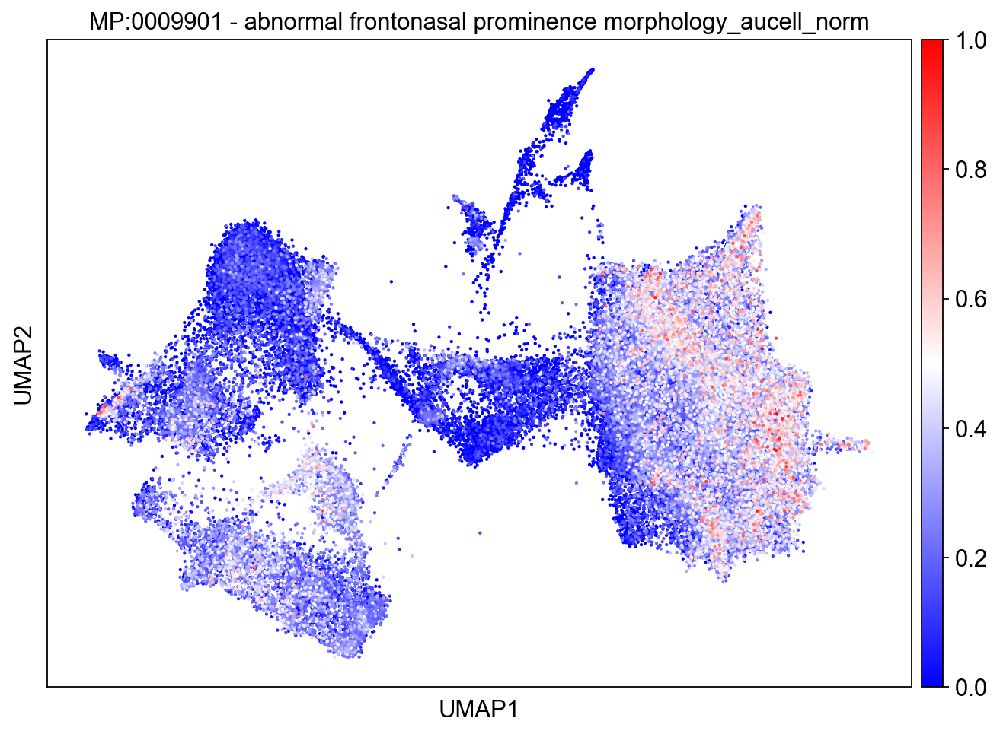

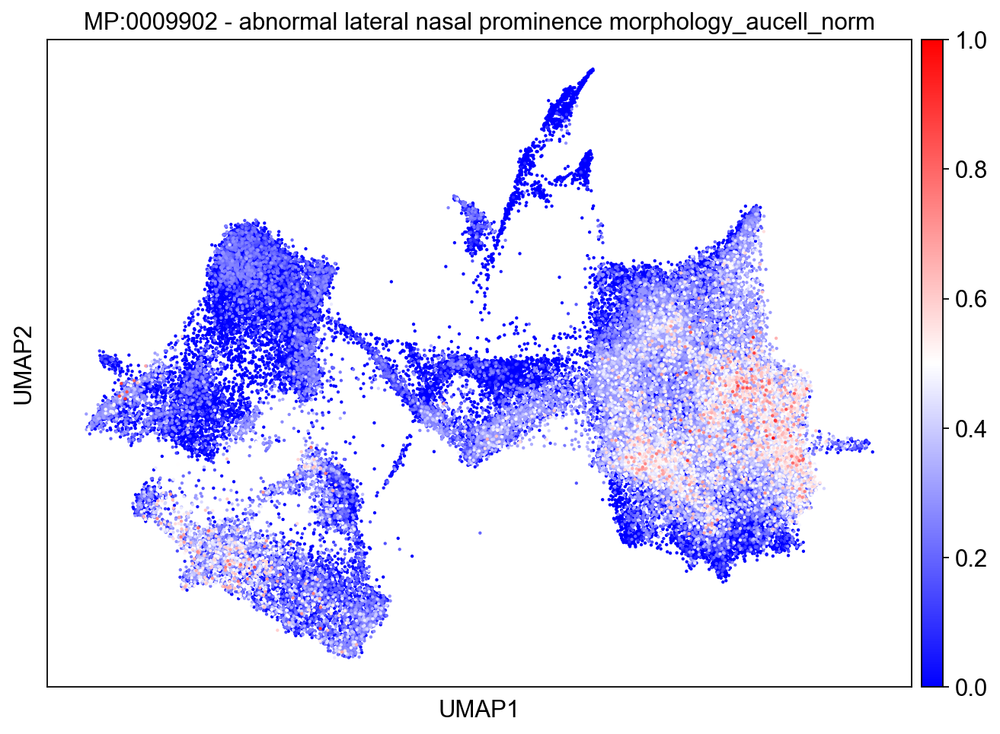

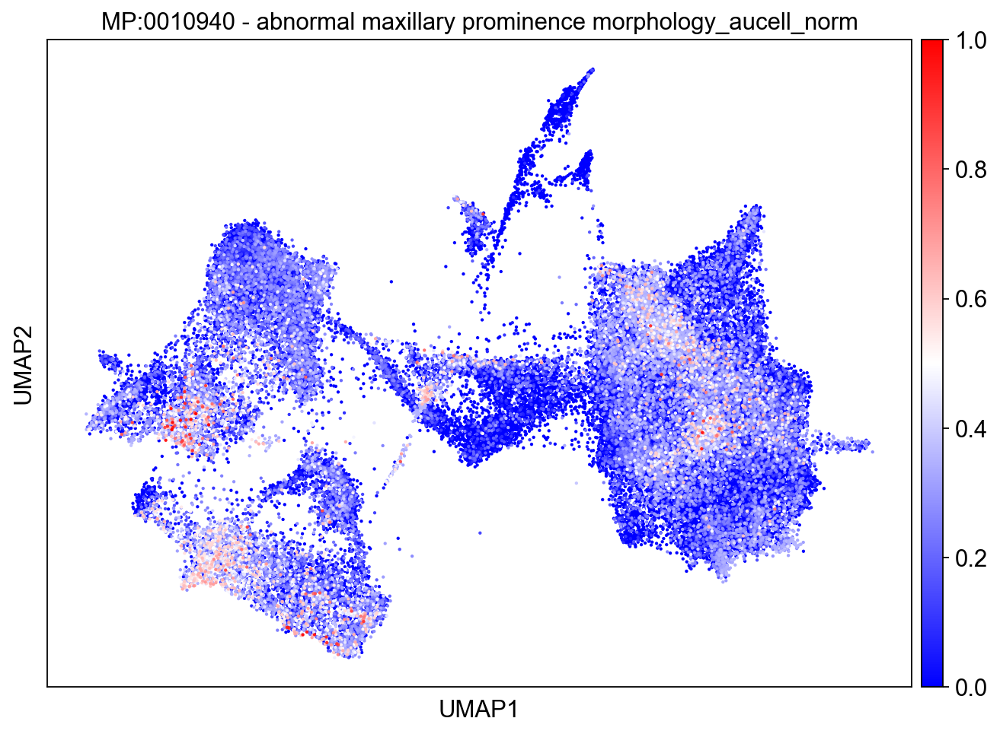

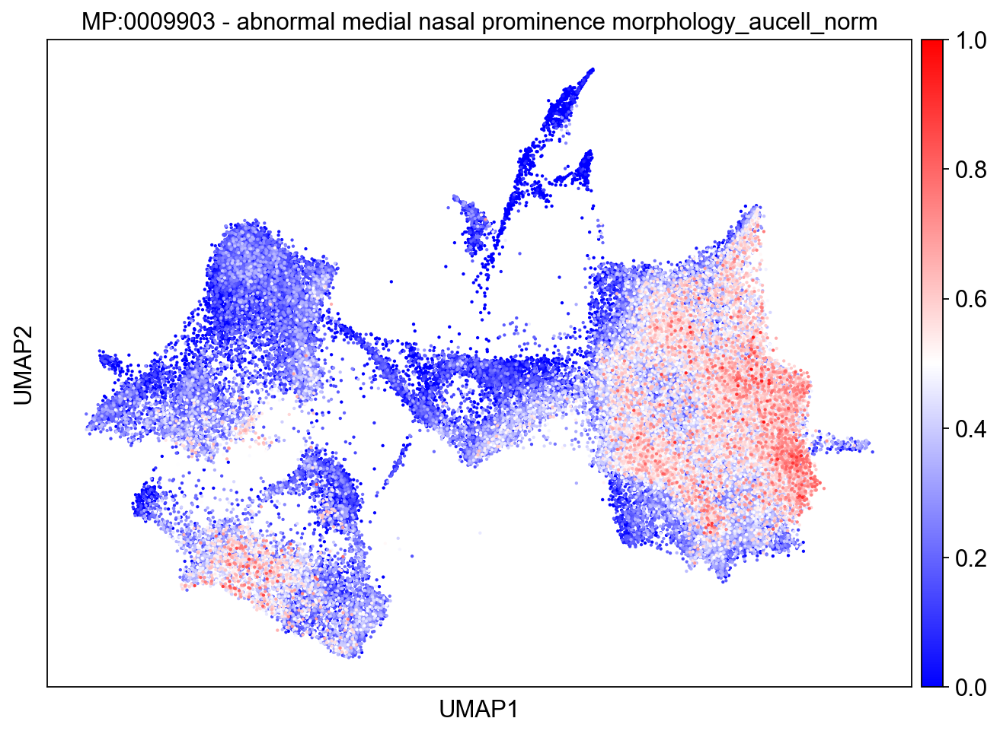

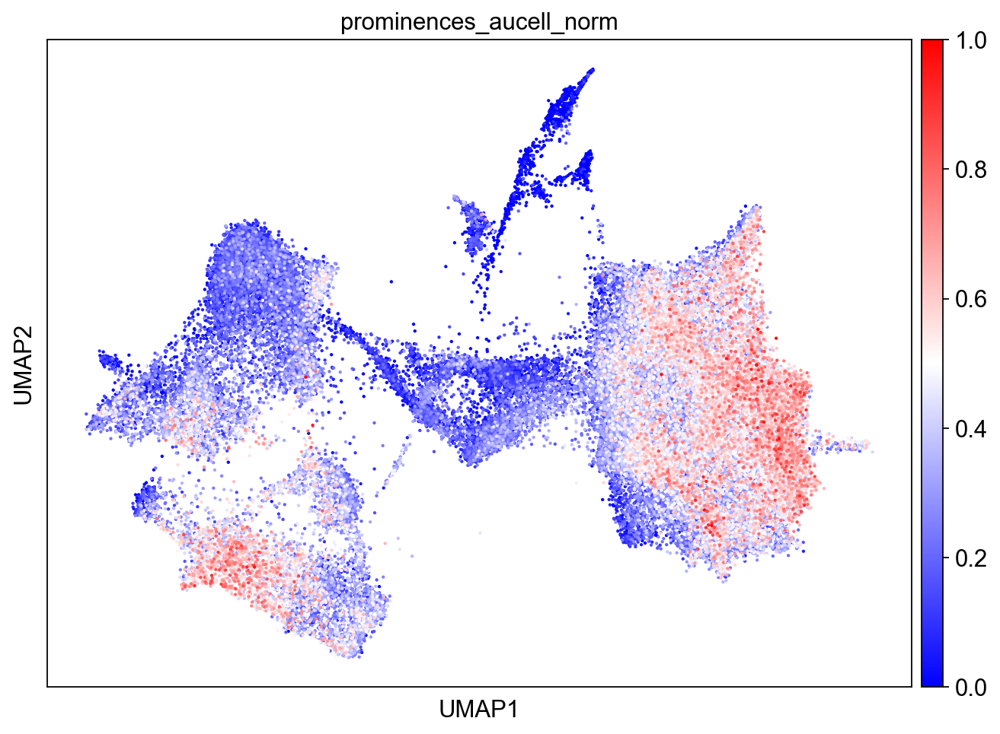

In [125]:
#run aucell
geneset_names=list(gene_set_dict.keys())
ov.single.pathway_aucell(adata,
                            pathway_names=geneset_names,
                            pathways_dict=gene_set_dict)


from pathlib import Path

save_loc = './figures/GWAS_aucell/revision'
sc._settings.ScanpyConfig.figdir=Path(save_loc) #set figdir
sc.set_figure_params(figsize=[10,7])

import matplotlib.pyplot as plt
plt.rcParams['svg.fonttype'] = 'none'

for disease in [i+'_aucell' for i in geneset_names]:
    sc.pl.embedding(adata,
                basis='umap',
                color=[disease],
                ncols = 1,size = 15, cmap = 'bwr',vmin = 0, save = 'freeaxis_aucell_'+disease+'.svg')

##normalise aucell score between 0 and 1. (x-min(x))/(max(x)-min(x))
for disease in [i+'_aucell' for i in geneset_names]:
    adata.obs[disease+'_norm'] = (adata.obs[disease]-min(adata.obs[disease]))/(max(adata.obs[disease])-min(adata.obs[disease]))
    sc.pl.embedding(adata,
                basis='umap',
                color=[disease+'_norm'],
                ncols = 1,size = 15, cmap = 'bwr',vmin = 0, save = 'norm_aucell_'+disease+'.svg')

#adata.write('anndata_objects/adata_all_aucell.h5ad')

In [130]:
adata

AnnData object with n_obs × n_vars = 58973 × 21619
    obs: 'Clusters', '_X', '_Y', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'sample', 'barcode', 'batch', 'doublet_score', 'predicted_doublets', 'predicted_doublets_based_on_10x_chromium_spec', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'pct_counts_unspliced', 'pred_doubl_cat', 'stage', 'S_score', 'G2M_score', 'phase', 'topic_0', 'topic_1', 'topic_2', 'topic_3', 'topic_4', 'topic_5', 'topic_6', 'topic_7', 'topic_8', 'topic_9', 'leiden', 'annotation_all', 'EFO_0007841_aucell', 'random_1_aucell', 'EFO_0007841 - facial morphology measurement(GWAS)_aucell', 'EFO_0007843 - nose morphology measurement(GWAS)_aucell', 'EFO_1000720 - keratosis_aucell', 'EFO_0005917 - generalised epilepsy_aucell', 'EFO_0005410 - tooth agenesis_aucell', 'EFO_0000540 - immune system disease_aucell', 'MONDO_0019548 - autosomal dominant intermediate Charcot-Marie-Tooth disease_a

In [131]:
adata_mesen = sc.read('anndata_objects/interactive/mesen_all.h5ad')

In [132]:
s = adata[adata_mesen.obs.index].obs.loc[:,['prominences_aucell','prominences_aucell_norm', 
                                            'EFO_0007841_0.1 - facial morphology measurement(GWAS)_aucell', 
                                            'disgenet_aucell', 'disgenet_cleft_aucell', 
                                            'EFO_0007841_0.1 - facial morphology measurement(GWAS)_aucell_norm', 
                                            'disgenet_aucell_norm', 'disgenet_cleft_aucell_norm']]

adata_mesen.obs = pd.concat([adata_mesen.obs, s], axis=1)

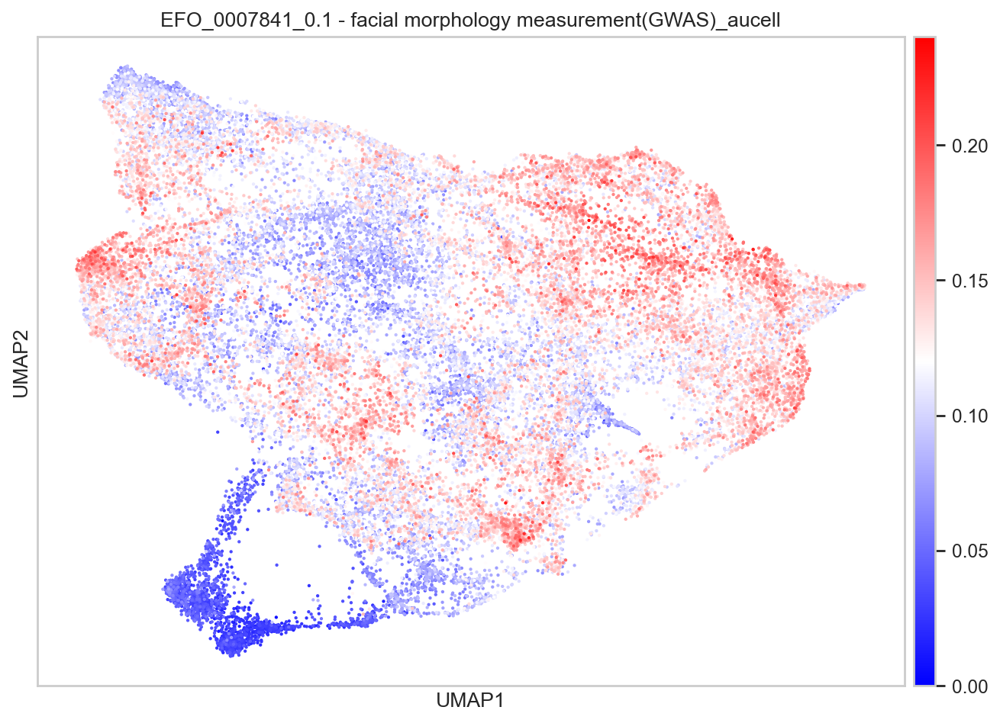

In [134]:
sc.pl.embedding(adata_mesen,
                basis='umap',
                color=['EFO_0007841_0.1 - facial morphology measurement(GWAS)_aucell'],
                ncols = 1,size = 15, cmap = 'bwr',vmin = 0,)

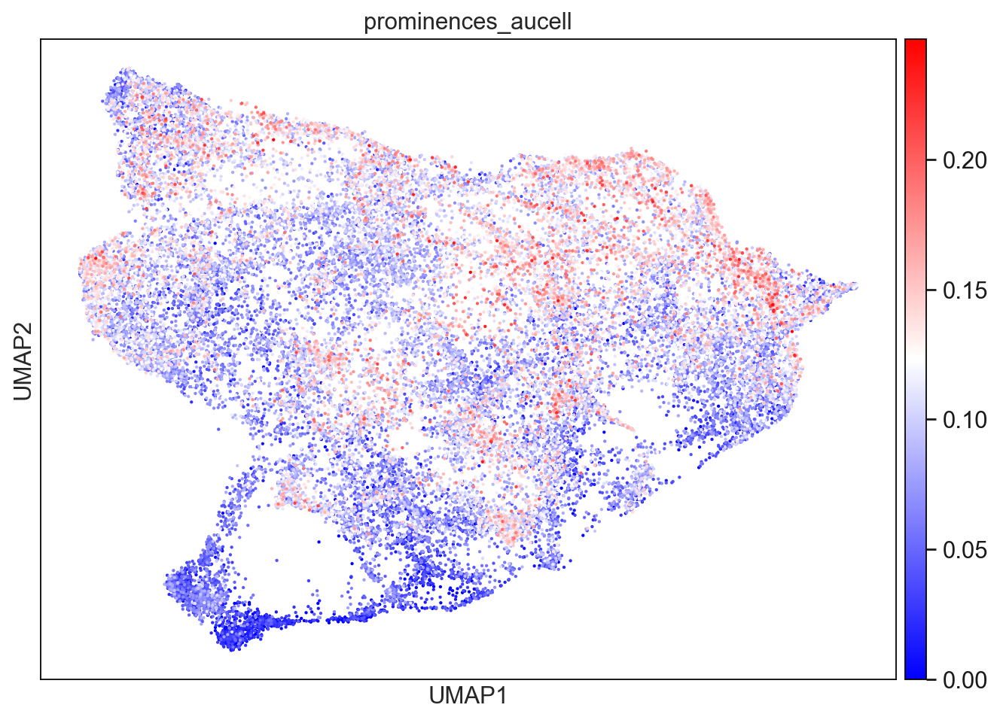

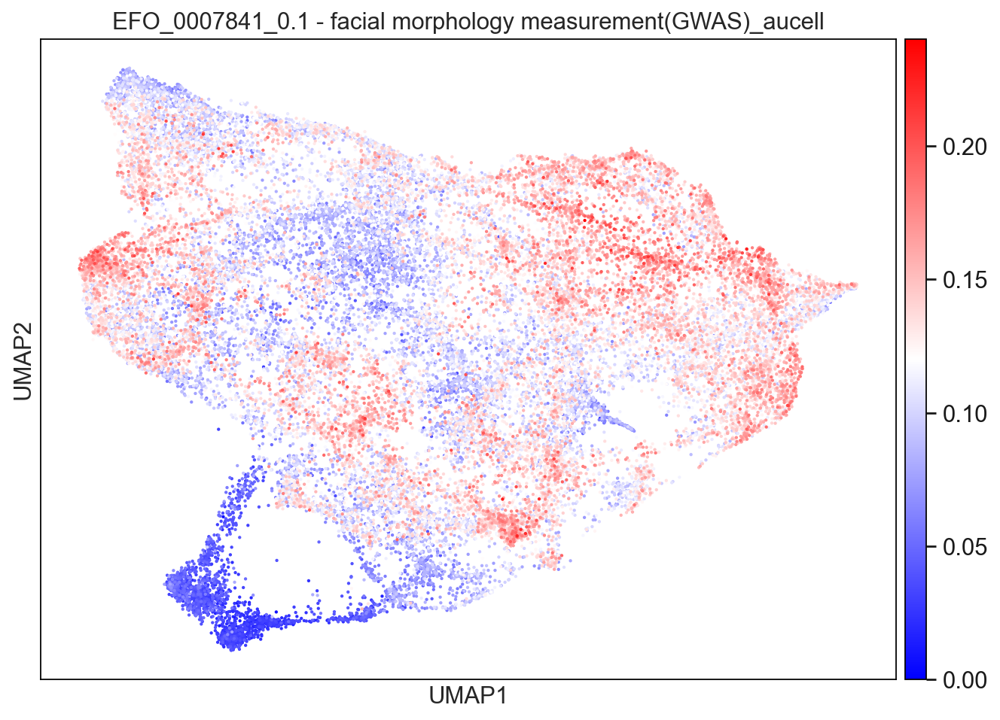

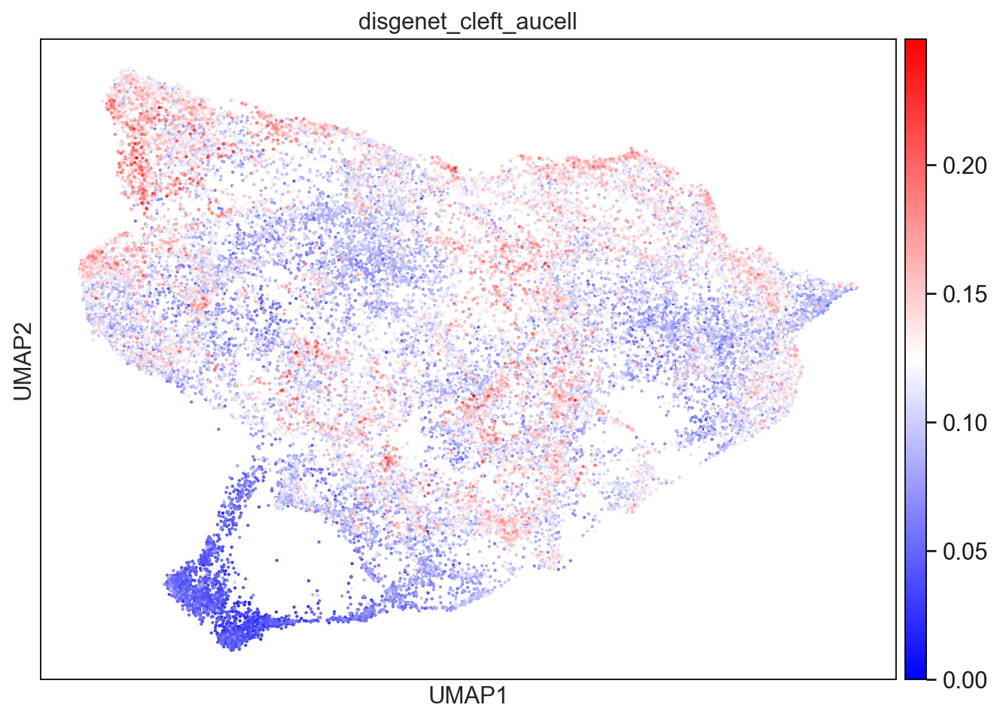

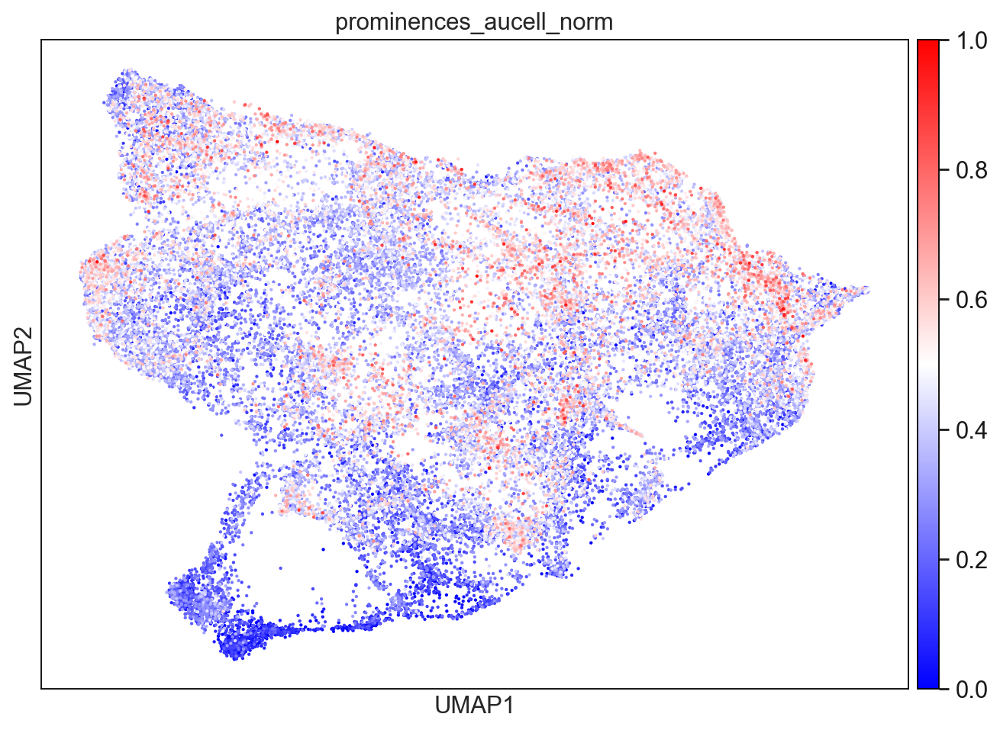

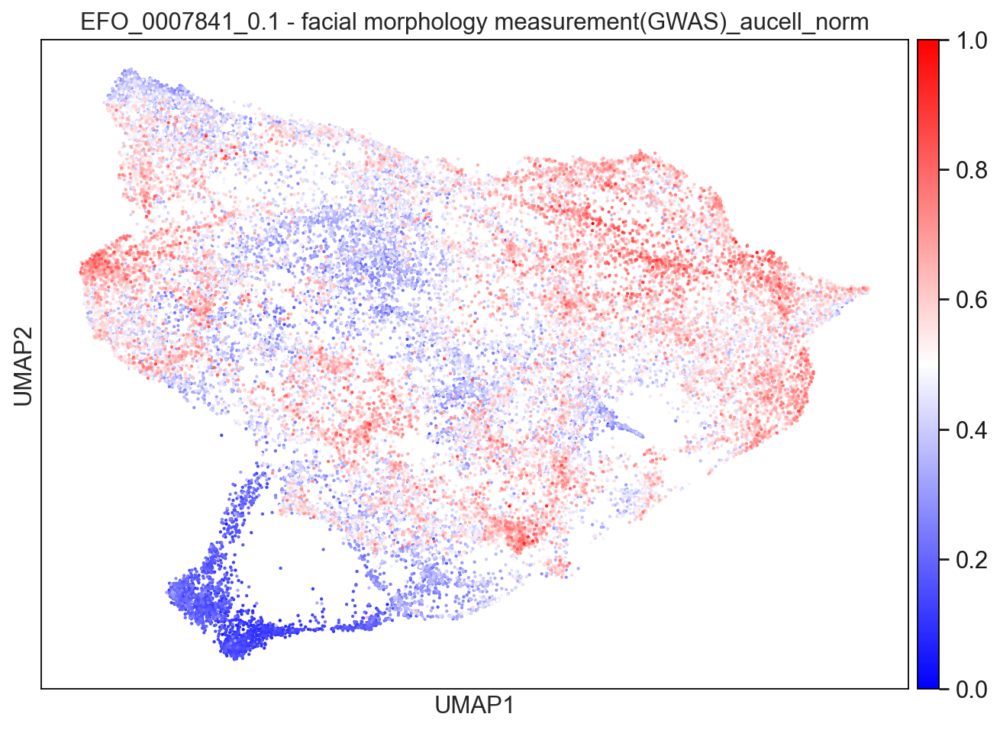

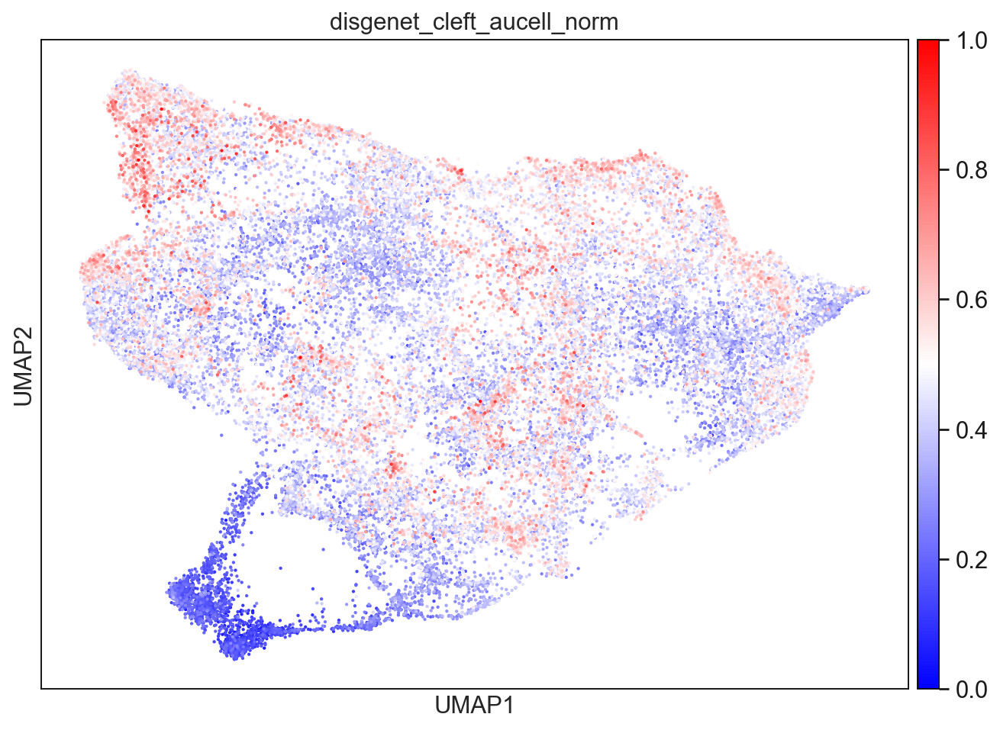

In [135]:
save_loc = './figures/GWAS_aucell/revision'
sc._settings.ScanpyConfig.figdir=Path(save_loc) #set figdir
sc.set_figure_params(figsize=[10,7])

import matplotlib.pyplot as plt
plt.rcParams['svg.fonttype'] = 'none'

for disease in ['prominences_aucell','EFO_0007841_0.1 - facial morphology measurement(GWAS)_aucell','disgenet_cleft_aucell',]:
    sc.pl.embedding(adata_mesen,
                basis='umap',
                color=[disease],
                ncols = 1,size = 15, cmap = 'bwr',vmin = 0, save = 'mesen_freeaxis_aucell_'+disease+'.svg')

##normalise aucell score between 0 and 1. (x-min(x))/(max(x)-min(x))
for disease in ['prominences_aucell','EFO_0007841_0.1 - facial morphology measurement(GWAS)_aucell','disgenet_cleft_aucell']:
    sc.pl.embedding(adata_mesen,
                basis='umap',
                color=[disease+'_norm'],
                ncols = 1,size = 15, cmap = 'bwr',vmin = 0, save = 'mesen_norm_aucell_'+disease+'.svg')

In [136]:
adata_mesen

AnnData object with n_obs × n_vars = 33371 × 19928
    obs: 'sample', 'barcode', 'batch', 'doublet_score', 'predicted_doublets', 'predicted_doublets_based_on_10x_chromium_spec', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'pct_counts_unspliced', 'pred_doubl_cat', 'stage', 'S_score', 'G2M_score', 'phase', 'palantir_pseudotime', 'palantir_entropy', 'macrostates_fwd', 'term_states_fwd', 'term_states_fwd_probs', 'annotation_2024', 'annotation_coarse_2024', 'annotation_paper_coarse', 'E11_annotation', 'n_counts', 'E10_annotation', 'annotation_early', 'E11_prom', 'annotation_early_prom', 'E12_annotation_groups', 'E12-E14_annotation', 'Palatal & Osteogenic Mesenchyme', 'E12_Palatal & Osteogenic Mesenchyme', 'E13_Palatal & Osteogenic Mesenchyme', 'E14_Palatal & Osteogenic Mesenchyme', 'Nasal Cavity & Chondrogenic Mesenchyme', 'leiden_test', 'E12_Nasal Cavity & Chondrogenic Mesenchyme', 'E13_Nasal Cavity & Chondrogenic Mesenchyme'

In [142]:
bwr_grey = mpl.colors.LinearSegmentedColormap.from_list('my_gradient', (
    # Edit this gradient at https://eltos.github.io/gradient/#0034FF-F0F0F0-FF000C
    (0.000, (0.000, 0.204, 1.000)),
    (0.500, (0.941, 0.941, 0.941)),
    (1.000, (1.000, 0.000, 0.047))))

In [139]:
aucell_per_stage = {}
aucell_per_stage_prop={}
annotation = 'annotation_all'
EFO = 'disgenet_cleft_aucell'
for stage in list(adata_mesen.obs['stage'].cat.categories):
    adata_tmp = adata_mesen[adata_mesen.obs['stage']==stage]
    adata_tmp = adata_tmp[adata_tmp.obs[annotation].isin(list(adata_tmp.obs[annotation].value_counts()[adata_tmp.obs[annotation].value_counts()>20].index))]
    adata_tmp.obs[EFO] = adata_tmp.obs[EFO]/len(adata_tmp)
    aucell_per_stage[stage] = adata_tmp.obs.groupby([annotation])[EFO].sum()
    test_norm = aucell_per_stage[stage].div(adata_tmp.obs[annotation].value_counts())
    test_norm = test_norm/sum(test_norm)
    test_norm = test_norm*aucell_per_stage[stage].sum()
    aucell_per_stage_prop[stage] = test_norm
    #aucell_per_stage_prop[stage] = (aucell_per_stage[stage].div(adata_tmp.obs[annotation].value_counts())/sum(aucell_per_stage[stage].div(adata_tmp.obs[annotation].value_counts())))*aucell_per_stage[stage].sum()
    #aucell_per_stage[stage] = aucell_per_stage[stage]/len(adata_tmp)
    #aucell_per_stage[stage] = aucell_per_stage[stage].div(adata_tmp.obs[annotation].value_counts())
#aucell_per_stage

In [138]:
adata_tmp.obs.groupby([annotation])[EFO].mean()

annotation_all
Incisor                            0.000075
Molar                              0.000054
MxP Mesenchyme                     0.000062
Osteoblast                         0.000052
Osteomesenchyme                    0.000063
Palatal Shelf - Anterior           0.000061
Palatal Shelf - Posterior          0.000054
Primary Palate                     0.000063
Chondrocytes - Anterior Capsule    0.000079
Chondrocytes - Septum/Capsule      0.000070
Nasal Cavity - Dorsal              0.000062
Nasal Cavity - Ventral             0.000060
Perichondrium                      0.000078
VNO Mesenchyme                     0.000057
Dermal Condensate                  0.000050
Lip Fibroblasts                    0.000052
Lip-Nostril Fusion                 0.000068
Philtrum                           0.000069
Roof - Sim1                        0.000052
Whisker Pad                        0.000048
Periocular Mesenchyme              0.000044
Name: disgenet_aucell, dtype: float64

In [181]:
adata_mesen.obs['stage'].value_counts()

stage
13    12155
12    11694
11     4621
14     2125
10     1527
8       815
9       434
Name: count, dtype: int64

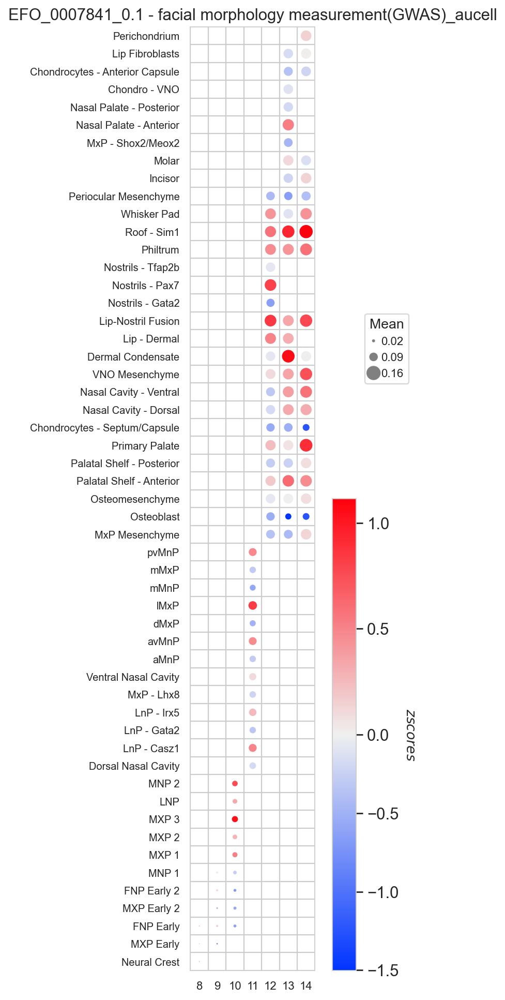

In [182]:
import matplotlib as mpl
mpl.rcParams.update({"axes.grid" : False})
plt.rcParams['svg.fonttype'] = 'none'
aucell_per_stage = {}
aucell_per_stage_mean={}
aucell_per_stage_z = {}
annotation = 'annotation_all'
#EFO = 'disgenet_aucell'
#EFO = 'random_2_aucell'
#EFO = 'disgenet_aucell'
EFO = 'EFO_0007841_0.1 - facial morphology measurement(GWAS)_aucell'

for stage in list(adata_mesen.obs['stage'].cat.categories):
    adata_tmp = adata_mesen[adata_mesen.obs['stage']==stage]
    adata_tmp = adata_tmp[adata_tmp.obs[annotation].isin(list(adata_tmp.obs[annotation].value_counts()[adata_tmp.obs[annotation].value_counts()>20].index))]
    #adata_tmp.obs[EFO] = adata_tmp.obs[EFO]/len(adata_tmp)
    aucell_per_stage_mean[stage] = adata_tmp.obs.groupby([annotation])[EFO].mean()
    aucell_per_stage_z[stage] = (aucell_per_stage_mean[stage] - adata_tmp.obs[EFO].mean())/adata_tmp.obs[EFO].std()
    #aucell_per_stage[stage] = aucell_per_stage[stage] * sum(adata_tmp.obs[EFO]/len(adata_tmp)*10)**3
    
    #aucell_per_stage_prop[stage] = (aucell_per_stage[stage].div(adata_tmp.obs[annotation].value_counts())/sum(aucell_per_stage[stage].div(adata_tmp.obs[annotation].value_counts())))*aucell_per_stage[stage].sum()
    #aucell_per_stage[stage] = aucell_per_stage[stage]/len(adata_tmp)
    #aucell_per_stage[stage] = aucell_per_stage[stage].div(adata_tmp.obs[annotation].value_counts())
#aucell_per_stage

dotplot_df = pd.DataFrame.from_dict(aucell_per_stage_mean,orient = 'index')
dotplot_df = dotplot_df.melt(ignore_index=False).reset_index()
z_scores = pd.DataFrame.from_dict(aucell_per_stage_z,orient = 'index')
z_scores = z_scores.melt(ignore_index=False).reset_index()
dotplot_df['z_score'] = z_scores['value']
dotplot_df = dotplot_df.dropna()
dotplot_df = dotplot_df.reset_index(drop=True)

from matplotlib.legend_handler import HandlerPatch
import matplotlib.patches as mpatches
from matplotlib.collections import PatchCollection


#define colnames
size = 'value'
color = 'z_score'
x_label = 'index'
y_label = 'variable'
cmap=bwr_grey
dot_max = .2 #s.max()


ylabels = dotplot_df[y_label].unique().tolist()
xlabels = dotplot_df[x_label].unique().tolist()
xn = len(xlabels)
yn = len(ylabels)    
s = dotplot_df[size].values
c = dotplot_df[color].values


fig, ax = plt.subplots(figsize=(10,15))
ax.set_xlim(-0.5, xn-0.5)
ax.set_ylim(-0.5, yn-0.5)
ax.set(xticks=np.arange(xn), yticks=np.arange(yn), yticklabels=ylabels)
ax.set_xticklabels(xlabels,)
ax.set_xticks(np.arange(xn)-0.5, minor=True)
ax.set_yticks(np.arange(yn)-0.5, minor=True)
ax.grid(which='minor')
ax.set_aspect("equal", "box")

R = s/dot_max/2
circles = [plt.Circle((xlabels.index(dotplot_df.loc[i, x_label]), ylabels.index(dotplot_df.loc[i, y_label])), radius=r) for i, r in enumerate(R)]
col = PatchCollection(circles, array=c, cmap=cmap, norm = mpl.colors.TwoSlopeNorm(vcenter=0,))
sc=ax.add_collection(col)
cbar=fig.colorbar(col,shrink = .5,anchor = (-0.2, 0.0)).set_label('$z scores$', rotation=270, size=12,labelpad=15)

smax=(R*28).max()
smin=(R*28).min()
smid=(smax+smin)/2
texts = [str(round(dotplot_df['value'].min(),2)),
         str(round((dotplot_df['value'].max()+dotplot_df['value'].min())/2,2)),
        str(round(dotplot_df['value'].max(),2))]


class HandlerEllipse(HandlerPatch):
    def create_artists(self, legend, orig_handle,
                       xdescent, ydescent, width, height, fontsize, trans):
        center = 0.5 * width - 0.5 * xdescent, 0.5 * height - 0.5 * ydescent
        p = mpatches.Ellipse(xy=center, width=orig_handle.width,
                                        height=orig_handle.height)
        self.update_prop(p, orig_handle, legend)
        p.set_transform(trans)
        return [p]
    
c = [mpatches.Ellipse((), width=smin, height=smin, color="grey"),
     mpatches.Ellipse((), width=smid, height=smid, color="grey"),
     mpatches.Ellipse((), width=smax, height=smax, color="grey"),
    ]

legend = ax.legend(c,texts, handler_map={mpatches.Ellipse: HandlerEllipse()},title="Mean",bbox_to_anchor=(.8, .6, 1.0, .102),fontsize=10)
plt.setp(legend.get_title(),fontsize=12)
plt.tick_params(top=False, bottom=False, left=False, right=False, which = 'both')
plt.yticks(fontsize=9,)
plt.xticks(fontsize=10,)
plt.title(EFO)
plt.savefig('figures/AUCell_report/dotplots/'+EFO+'.svg',bbox_inches='tight')
plt.show()


In [151]:
del sc

In [156]:
from copy import copy
import matplotlib as mpl
reds = copy(mpl.cm.Reds)
reds.set_under("lightgray")
def matplotlib_to_sns(cmap, pl_entries):
    h = 1.0/(pl_entries-1)
    pl_colorscale = []

    for k in range(pl_entries):
        C = list(map(np.uint8, np.array(cmap(k * h)[:3]) * 255))
        pl_colorscale.append((C[0], C[1], C[2]))

    return pl_colorscale

sns_reds = matplotlib_to_sns(reds, 255)
sns_reds = ['#%02x%02x%02x' % x for x in sns_reds]
sns_reds[0] = '#ffffff'
#plotly_reds[0] = [0.0, (211, 211, 211)]

In [170]:
disease_list = ['EFO_0007841_0.1 - facial morphology measurement(GWAS)','disgenet','prominences']
anndata_object = adata
annotation = 'annotation_all'
heatmap_score = 10

output_dir = 'figures/AUCell_report/all_cells/integrated/'
import scanpy as sc
sc.tl.rank_genes_groups(anndata_object,groupby = annotation,
                        method = 'wilcoxon',
                       )

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import scanpy as sc
from matplotlib.patches import Rectangle

for disease in disease_list:
        with PdfPages(output_dir+disease+'.pdf') as pdf:
            aucell = disease+'_aucell'
            hue = annotation
            
            plt.rcParams['figure.figsize'] = (7, 6)
            ax = sc.pl.umap(anndata_object,
                        color=[aucell,aucell+'_norm'],
                        show = False,ncols = 2,cmap = 'bwr',vmin = 0,)
            for p in ax:
                p.set_rasterized(True)
            pdf.savefig(dpi=150)
            plt.close()


# plt parameters
            plt.rcParams['figure.figsize'] = (10.0, 4)
            plt.style.use('seaborn-dark-palette')
            plt.rcParams['axes.grid'] = True
            plt.rcParams["patch.force_edgecolor"] = True
            sns.set_style("whitegrid", {'axes.grid' : False})


            replicates = anndata_object.obs.loc[:,[aucell,hue,'batch']]
            replicates['annotation_all'] = pd.Categorical(replicates['annotation_all'], ['Mesenchyme','Brain','Ectoderm','Neural Crest','Glia','Endothelium','Immune Cells','Mesoderm','Muscle'])

            heatmap_df = sc.get.rank_genes_groups_df(anndata_object, group = None)
            heatmap_df = heatmap_df[heatmap_df['scores']>heatmap_score]
            heatmap_df = pd.pivot(heatmap_df, index=['names'], columns = 'group',values = 'logfoldchanges',) #Reshape from long to wide
            heatmap_df = heatmap_df.fillna(0)


            p = sns.histplot(
                replicates,
                x=aucell, hue=hue,
                multiple="stack",
                common_bins=True,
                common_norm=True,
            )
            plt.title('AUCell stacked histogram - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_stacked_histogram-'+disease+'.svg')
            plt.close()

# plot replicates
            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = True)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - common norm - '+ disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-common_norm-'+disease+'.svg')
            plt.close()

            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = False)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - individual norm - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-individual_norm-'+disease+'.svg')
            plt.close()

    
#plot on batches
            hue = 'batch'
            p = sns.histplot(
                replicates,
                x=aucell, hue=hue,
                multiple="stack",
                common_bins=True,
                common_norm=True,
            )
            plt.title('AUCell stacked histogram - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_stacked_histogram-'+disease+'_batch'+'.svg')
            plt.close()
    
            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = True)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - common norm - '+ disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-common_norm-'+disease+'_batch'+'.svg')
            plt.close()

            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = False)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - individual norm - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-individual_norm-'+disease+'_batch'+'.svg')
            plt.close()

            p = sns.clustermap(heatmap_df.loc[heatmap_df.index.intersection(gene_set_dict[disease])],
                        cmap = sns_reds, vmax = 3, vmin = 0,xticklabels = True,figsize=(10, 15), yticklabels=True
                      )
    
            plt.title('Gene set heatmap - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'Gene_set_heatmap-'+disease+'.svg')
            plt.close()

In [159]:
disease_list = ['EFO_0007841_0.1 - facial morphology measurement(GWAS)','disgenet','prominences']
anndata_object = adata[adata.obs['batch'].isin(['adata10','adata11','adata12','adata13','adata14'])]
annotation = 'annotation_all'
heatmap_score = 10

output_dir = 'figures/AUCell_report/all_cells/kaucka/'

sc.tl.rank_genes_groups(anndata_object,groupby = annotation,
                        method = 'wilcoxon',
                       )

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle

for disease in disease_list:
        with PdfPages(output_dir+disease+'.pdf') as pdf:
            aucell = disease+'_aucell'
            hue = annotation
            
            plt.rcParams['figure.figsize'] = (7, 6)
            ax = sc.pl.umap(anndata_object,
                        color=[aucell,aucell+'_norm'],
                        show = False,ncols = 2,cmap = 'bwr',vmin = 0,)
            for p in ax:
                p.set_rasterized(True)
            pdf.savefig(dpi=150)
            plt.close()


# plt parameters
            plt.rcParams['figure.figsize'] = (10.0, 4)
            plt.style.use('seaborn-dark-palette')
            plt.rcParams['axes.grid'] = True
            plt.rcParams["patch.force_edgecolor"] = True
            sns.set_style("whitegrid", {'axes.grid' : False})


            replicates = anndata_object.obs.loc[:,[aucell,hue,'batch']]
            replicates['annotation_all'] = pd.Categorical(replicates['annotation_all'], ['Mesenchyme','Brain','Ectoderm','Neural Crest','Glia','Endothelium','Immune Cells','Mesoderm','Muscle'])

            heatmap_df = sc.get.rank_genes_groups_df(anndata_object, group = None)
            heatmap_df = heatmap_df[heatmap_df['scores']>heatmap_score]
            heatmap_df = pd.pivot(heatmap_df, index=['names'], columns = 'group',values = 'logfoldchanges',) #Reshape from long to wide
            heatmap_df = heatmap_df.fillna(0)


            p = sns.histplot(
                replicates,
                x=aucell, hue=hue,
                multiple="stack",
                common_bins=True,
                common_norm=True,
            )
            plt.title('AUCell stacked histogram - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_stacked_histogram-'+disease+'.svg')
            plt.close()

# plot replicates
            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = True)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - common norm - '+ disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-common_norm-'+disease+'.svg')
            plt.close()

            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = False)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - individual norm - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-individual_norm-'+disease+'.svg')
            plt.close()

    
#plot on batches
            hue = 'batch'
            p = sns.histplot(
                replicates,
                x=aucell, hue=hue,
                multiple="stack",
                common_bins=True,
                common_norm=True,
            )
            plt.title('AUCell stacked histogram - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_stacked_histogram-'+disease+'_batch'+'.svg')
            plt.close()
    
            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = True)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - common norm - '+ disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-common_norm-'+disease+'_batch'+'.svg')
            plt.close()

            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = False)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - individual norm - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-individual_norm-'+disease+'_batch'+'.svg')
            plt.close()

            p = sns.clustermap(heatmap_df.loc[heatmap_df.index.intersection(gene_set_dict[disease])],
                        cmap = sns_reds, vmax = 3, vmin = 0,xticklabels = True,figsize=(10, 15), yticklabels=True
                      )
    
            plt.title('Gene set heatmap - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'Gene_set_heatmap-'+disease+'.svg')
            plt.close()

In [160]:
disease_list = ['EFO_0007841_0.1 - facial morphology measurement(GWAS)','disgenet','prominences']
anndata_object = adata_mesen
annotation = 'annotation_all_coarse'
heatmap_score = 10

output_dir = 'figures/AUCell_report/mesen/all_coarse/'

sc.tl.rank_genes_groups(anndata_object,groupby = annotation,
                        method = 'wilcoxon',
                       )

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle

for disease in disease_list:
        with PdfPages(output_dir+disease+'.pdf') as pdf:
            aucell = disease+'_aucell'
            hue = annotation
            
            plt.rcParams['figure.figsize'] = (7, 6)
            ax = sc.pl.umap(anndata_object,
                        color=[aucell,aucell+'_norm'],
                        show = False,ncols = 2,cmap = 'bwr',vmin = 0,)
            for p in ax:
                p.set_rasterized(True)
            pdf.savefig(dpi=150)
            plt.close()


# plt parameters
            plt.rcParams['figure.figsize'] = (10.0, 4)
            plt.style.use('seaborn-dark-palette')
            plt.rcParams['axes.grid'] = True
            plt.rcParams["patch.force_edgecolor"] = True
            sns.set_style("whitegrid", {'axes.grid' : False})


            replicates = anndata_object.obs.loc[:,[aucell,hue,'batch']]
            replicates['annotation_all'] = pd.Categorical(replicates['annotation_all_coarse'], ['Nasal Cavity & Chondrogenic Mesenchyme','Dermal Mesenchyme',
                                                                                                'Palatal & Osteogenic Mesenchyme','Frontonasal Prominence', 'Maxillary Prominence',
                                                                                                'Neural Crest',
                                                                                                'Periocular Mesenchyme',])

            heatmap_df = sc.get.rank_genes_groups_df(anndata_object, group = None)
            heatmap_df = heatmap_df[heatmap_df['scores']>heatmap_score]
            heatmap_df = pd.pivot(heatmap_df, index=['names'], columns = 'group',values = 'logfoldchanges',) #Reshape from long to wide
            heatmap_df = heatmap_df.fillna(0)


            p = sns.histplot(
                replicates,
                x=aucell, hue=hue,
                multiple="stack",
                common_bins=True,
                common_norm=True,
            )
            plt.title('AUCell stacked histogram - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_stacked_histogram-'+disease+'.svg')
            plt.close()

# plot replicates
            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = True)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - common norm - '+ disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-common_norm-'+disease+'.svg')
            plt.close()

            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = False)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - individual norm - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-individual_norm-'+disease+'.svg')
            plt.close()

    
#plot on batches
            hue = 'batch'
            p = sns.histplot(
                replicates,
                x=aucell, hue=hue,
                multiple="stack",
                common_bins=True,
                common_norm=True,
            )
            plt.title('AUCell stacked histogram - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_stacked_histogram-'+disease+'_batch'+'.svg')
            plt.close()
    
            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = True)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - common norm - '+ disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-common_norm-'+disease+'_batch'+'.svg')
            plt.close()

            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = False)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - individual norm - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-individual_norm-'+disease+'_batch'+'.svg')
            plt.close()

            p = sns.clustermap(heatmap_df.loc[heatmap_df.index.intersection(gene_set_dict[disease])],
                        cmap = sns_reds, vmax = 3, vmin = 0,xticklabels = True,figsize=(10, 15), yticklabels=True
                      )
    
            plt.title('Gene set heatmap - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'Gene_set_heatmap-'+disease+'.svg')
            plt.close()

In [161]:
disease_list = ['EFO_0007841_0.1 - facial morphology measurement(GWAS)','disgenet','prominences']
anndata_object = adata_mesen[adata_mesen.obs['batch'].isin(['adata10','adata11','adata12','adata13','adata14'])]
annotation = 'annotation_all_coarse'
heatmap_score = 10

output_dir = 'figures/AUCell_report/mesen/kaucka_coarse/'

sc.tl.rank_genes_groups(anndata_object,groupby = annotation,
                        method = 'wilcoxon',
                       )

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle

for disease in disease_list:
        with PdfPages(output_dir+disease+'.pdf') as pdf:
            aucell = disease+'_aucell'
            hue = annotation
            
            plt.rcParams['figure.figsize'] = (7, 6)
            ax = sc.pl.umap(anndata_object,
                        color=[aucell,aucell+'_norm'],
                        show = False,ncols = 2,cmap = 'bwr',vmin = 0,)
            for p in ax:
                p.set_rasterized(True)
            pdf.savefig(dpi=150)
            plt.close()


# plt parameters
            plt.rcParams['figure.figsize'] = (10.0, 4)
            plt.style.use('seaborn-dark-palette')
            plt.rcParams['axes.grid'] = True
            plt.rcParams["patch.force_edgecolor"] = True
            sns.set_style("whitegrid", {'axes.grid' : False})


            replicates = anndata_object.obs.loc[:,[aucell,hue,'batch']]
            # replicates['annotation_all'] = pd.Categorical(replicates['annotation_all_coarse'], ['Nasal Cavity & Chondrogenic Mesenchyme','Dermal Mesenchyme',
            #                                                                                     'Palatal & Osteogenic Mesenchyme','Frontonasal Prominence', 'Maxillary Prominence',
            #                                                                                     'Neural Crest',
            #                                                                                     'Periocular Mesenchyme',])

            heatmap_df = sc.get.rank_genes_groups_df(anndata_object, group = None)
            heatmap_df = heatmap_df[heatmap_df['scores']>heatmap_score]
            heatmap_df = pd.pivot(heatmap_df, index=['names'], columns = 'group',values = 'logfoldchanges',) #Reshape from long to wide
            heatmap_df = heatmap_df.fillna(0)


            p = sns.histplot(
                replicates,
                x=aucell, hue=hue,
                multiple="stack",
                common_bins=True,
                common_norm=True,
            )
            plt.title('AUCell stacked histogram - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_stacked_histogram-'+disease+'.svg')
            plt.close()

# plot replicates
            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = True)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - common norm - '+ disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-common_norm-'+disease+'.svg')
            plt.close()

            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = False)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - individual norm - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-individual_norm-'+disease+'.svg')
            plt.close()

    
#plot on batches
            hue = 'batch'
            p = sns.histplot(
                replicates,
                x=aucell, hue=hue,
                multiple="stack",
                common_bins=True,
                common_norm=True,
            )
            plt.title('AUCell stacked histogram - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_stacked_histogram-'+disease+'_batch'+'.svg')
            plt.close()
    
            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = True)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - common norm - '+ disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-common_norm-'+disease+'_batch'+'.svg')
            plt.close()

            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = False)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - individual norm - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-individual_norm-'+disease+'_batch'+'.svg')
            plt.close()

            p = sns.clustermap(heatmap_df.loc[heatmap_df.index.intersection(gene_set_dict[disease])],
                        cmap = sns_reds, vmax = 3, vmin = 0,xticklabels = True,figsize=(10, 15), yticklabels=True
                      )
    
            plt.title('Gene set heatmap - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'Gene_set_heatmap-'+disease+'.svg')
            plt.close()

In [162]:
disease_list = ['EFO_0007841_0.1 - facial morphology measurement(GWAS)','disgenet','prominences']
anndata_object = adata_mesen
annotation = 'annotation_all'
heatmap_score = 10

output_dir = 'figures/AUCell_report/mesen/all_fine/'

sc.tl.rank_genes_groups(anndata_object,groupby = annotation,
                        method = 'wilcoxon',
                       )

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle

for disease in disease_list:
        with PdfPages(output_dir+disease+'.pdf') as pdf:
            aucell = disease+'_aucell'
            hue = annotation
            
            plt.rcParams['figure.figsize'] = (7, 6)
            ax = sc.pl.umap(anndata_object,
                        color=[aucell,aucell+'_norm'],
                        show = False,ncols = 2,cmap = 'bwr',vmin = 0,)
            for p in ax:
                p.set_rasterized(True)
            pdf.savefig(dpi=150)
            plt.close()


# plt parameters
            plt.rcParams['figure.figsize'] = (10.0, 4)
            plt.style.use('seaborn-dark-palette')
            plt.rcParams['axes.grid'] = True
            plt.rcParams["patch.force_edgecolor"] = True
            sns.set_style("whitegrid", {'axes.grid' : False})


            replicates = anndata_object.obs.loc[:,[aucell,hue,'batch']]
            # replicates['annotation_all'] = pd.Categorical(replicates['annotation_all_coarse'], ['Nasal Cavity & Chondrogenic Mesenchyme','Dermal Mesenchyme',
            #                                                                                     'Palatal & Osteogenic Mesenchyme','Frontonasal Prominence', 'Maxillary Prominence',
            #                                                                                     'Neural Crest',
            #                                                                                     'Periocular Mesenchyme',])

            heatmap_df = sc.get.rank_genes_groups_df(anndata_object, group = None)
            heatmap_df = heatmap_df[heatmap_df['scores']>heatmap_score]
            heatmap_df = pd.pivot(heatmap_df, index=['names'], columns = 'group',values = 'logfoldchanges',) #Reshape from long to wide
            heatmap_df = heatmap_df.fillna(0)


            p = sns.histplot(
                replicates,
                x=aucell, hue=hue,
                multiple="stack",
                common_bins=True,
                common_norm=True,
            )
            plt.title('AUCell stacked histogram - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_stacked_histogram-'+disease+'.svg')
            plt.close()

# plot replicates
            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = True)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - common norm - '+ disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-common_norm-'+disease+'.svg')
            plt.close()

            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = False)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - individual norm - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-individual_norm-'+disease+'.svg')
            plt.close()

    
#plot on batches
            hue = 'batch'
            p = sns.histplot(
                replicates,
                x=aucell, hue=hue,
                multiple="stack",
                common_bins=True,
                common_norm=True,
            )
            plt.title('AUCell stacked histogram - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_stacked_histogram-'+disease+'_batch'+'.svg')
            plt.close()
    
            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = True)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - common norm - '+ disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-common_norm-'+disease+'_batch'+'.svg')
            plt.close()

            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = False)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - individual norm - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-individual_norm-'+disease+'_batch'+'.svg')
            plt.close()

            p = sns.clustermap(heatmap_df.loc[heatmap_df.index.intersection(gene_set_dict[disease])],
                        cmap = sns_reds, vmax = 3, vmin = 0,xticklabels = True,figsize=(10, 15), yticklabels=True
                      )
    
            plt.title('Gene set heatmap - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'Gene_set_heatmap-'+disease+'.svg')
            plt.close()

In [163]:
disease_list = ['EFO_0007841_0.1 - facial morphology measurement(GWAS)','disgenet','prominences']
anndata_object = adata_mesen[adata_mesen.obs['batch'].isin(['adata10','adata11','adata12','adata13','adata14'])]
annotation = 'annotation_all'
heatmap_score = 10

output_dir = 'figures/AUCell_report/mesen/kaucka_fine/'

sc.tl.rank_genes_groups(anndata_object,groupby = annotation,
                        method = 'wilcoxon',
                       )

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle

for disease in disease_list:
        with PdfPages(output_dir+disease+'.pdf') as pdf:
            aucell = disease+'_aucell'
            hue = annotation
            
            plt.rcParams['figure.figsize'] = (7, 6)
            ax = sc.pl.umap(anndata_object,
                        color=[aucell,aucell+'_norm'],
                        show = False,ncols = 2,cmap = 'bwr',vmin = 0,)
            for p in ax:
                p.set_rasterized(True)
            pdf.savefig(dpi=150)
            plt.close()


# plt parameters
            plt.rcParams['figure.figsize'] = (10.0, 4)
            plt.style.use('seaborn-dark-palette')
            plt.rcParams['axes.grid'] = True
            plt.rcParams["patch.force_edgecolor"] = True
            sns.set_style("whitegrid", {'axes.grid' : False})


            replicates = anndata_object.obs.loc[:,[aucell,hue,'batch']]
            # replicates['annotation_all'] = pd.Categorical(replicates['annotation_all_coarse'], ['Nasal Cavity & Chondrogenic Mesenchyme','Dermal Mesenchyme',
            #                                                                                     'Palatal & Osteogenic Mesenchyme','Frontonasal Prominence', 'Maxillary Prominence',
            #                                                                                     'Neural Crest',
            #                                                                                     'Periocular Mesenchyme',])

            heatmap_df = sc.get.rank_genes_groups_df(anndata_object, group = None)
            heatmap_df = heatmap_df[heatmap_df['scores']>heatmap_score]
            heatmap_df = pd.pivot(heatmap_df, index=['names'], columns = 'group',values = 'logfoldchanges',) #Reshape from long to wide
            heatmap_df = heatmap_df.fillna(0)


            p = sns.histplot(
                replicates,
                x=aucell, hue=hue,
                multiple="stack",
                common_bins=True,
                common_norm=True,
            )
            plt.title('AUCell stacked histogram - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_stacked_histogram-'+disease+'.svg')
            plt.close()

# plot replicates
            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = True)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - common norm - '+ disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-common_norm-'+disease+'.svg')
            plt.close()

            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = False)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - individual norm - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-individual_norm-'+disease+'.svg')
            plt.close()

    
#plot on batches
            hue = 'batch'
            p = sns.histplot(
                replicates,
                x=aucell, hue=hue,
                multiple="stack",
                common_bins=True,
                common_norm=True,
            )
            plt.title('AUCell stacked histogram - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_stacked_histogram-'+disease+'_batch'+'.svg')
            plt.close()
    
            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = True)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - common norm - '+ disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-common_norm-'+disease+'_batch'+'.svg')
            plt.close()

            p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = False)
            ymin,ymax = p.get_ylim()
            sns.despine(top=True)
            plt.title('AUCell distribution plot - individual norm - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'AUCell_distribution_plot-individual_norm-'+disease+'_batch'+'.svg')
            plt.close()

            p = sns.clustermap(heatmap_df.loc[heatmap_df.index.intersection(gene_set_dict[disease])],
                        cmap = sns_reds, vmax = 3, vmin = 0,xticklabels = True,figsize=(10, 15), yticklabels=True
                      )
    
            plt.title('Gene set heatmap - '+disease)
            pdf.savefig(dpi=150)
            #plt.savefig(output_dir+'Gene_set_heatmap-'+disease+'.svg')
            plt.close()

In [186]:
disease_list = ['EFO_0007841_0.1 - facial morphology measurement(GWAS)','disgenet','prominences']
anndata_object = adata_mesen
annotation = 'annotation_all'

output_dir = 'figures/AUCell_report/mesen/all_fine/'

hue = annotation
for disease in disease_list:
    aucell = disease+'_aucell'
    replicates = anndata_object.obs.loc[:,[aucell,hue,'batch']]
    # plot replicates
    p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = True)
    ymin,ymax = p.get_ylim()
    sns.despine(top=True)
    plt.title('AUCell distribution plot - common norm - '+ disease)
    plt.savefig(output_dir+disease+'_common_norm.svg',bbox_inches='tight')
    #plt.savefig(output_dir+'AUCell_distribution_plot-common_norm-'+disease+'.svg')
    plt.close()

    p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = False)
    ymin,ymax = p.get_ylim()
    sns.despine(top=True)
    plt.title('AUCell distribution plot - individual norm - '+disease)
    plt.savefig(output_dir+disease+'_individual_norm.svg',bbox_inches='tight')
    #plt.savefig(output_dir+'AUCell_distribution_plot-individual_norm-'+disease+'.svg')
    plt.close()

In [187]:
anndata_object = adata_mesen[adata_mesen.obs['batch'].isin(['adata10','adata11','adata12','adata13','adata14'])]
annotation = 'annotation_all'
disease_list = ['EFO_0007841_0.1 - facial morphology measurement(GWAS)','disgenet','prominences']

output_dir = 'figures/AUCell_report/mesen/kaucka_fine/'

hue = annotation
for disease in disease_list:
    aucell = disease+'_aucell'
    replicates = anndata_object.obs.loc[:,[aucell,hue,'batch']]
    # plot replicates
    p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = True)
    ymin,ymax = p.get_ylim()
    sns.despine(top=True)
    plt.title('AUCell distribution plot - common norm - '+ disease)
    plt.savefig(output_dir+disease+'_common_norm.svg',bbox_inches='tight')
    #plt.savefig(output_dir+'AUCell_distribution_plot-common_norm-'+disease+'.svg')
    plt.close()

    p = sns.kdeplot(replicates, x = aucell, hue = hue, common_norm = False)
    ymin,ymax = p.get_ylim()
    sns.despine(top=True)
    plt.title('AUCell distribution plot - individual norm - '+disease)
    plt.savefig(output_dir+disease+'_individual_norm.svg',bbox_inches='tight')
    #plt.savefig(output_dir+'AUCell_distribution_plot-individual_norm-'+disease+'.svg')
    plt.close()

In [88]:
xls = pd.read_excel("Supp_table - EFO_used_in_AUCell_hvg.xlsx", sheet_name=['EFO_0007841_genes_df', 'EFO_0005917_genes_df','EFO_1000720_genes_df','MONDO_0019548_genes_df','EFO_0000540_genes_df'])
xls['EFO_0007841_genes_df'] = xls['EFO_0007841_genes_df'][xls['EFO_0007841_genes_df']['targetId'].isin(gene_set_dict['EFO_0007841 - facial morphology measurement(GWAS)'])]
xls['EFO_0005917_genes_df'] = xls['EFO_0005917_genes_df'][xls['EFO_0005917_genes_df']['targetId'].isin(gene_set_dict['EFO_0005917 - generalised epilepsy'])]
xls['EFO_1000720_genes_df'] = xls['EFO_1000720_genes_df'][xls['EFO_1000720_genes_df']['targetId'].isin(gene_set_dict['EFO_1000720 - keratosis'])]
xls['MONDO_0019548_genes_df'] = xls['MONDO_0019548_genes_df'][xls['MONDO_0019548_genes_df']['targetId'].isin(gene_set_dict['MONDO_0019548 - autosomal dominant intermediate Charcot-Marie-Tooth disease'])]
xls['EFO_0000540_genes_df'] = xls['EFO_0000540_genes_df'][xls['EFO_0000540_genes_df']['targetId'].isin(gene_set_dict['EFO_0000540 - immune system disease'])]

In [89]:
with pd.ExcelWriter("Supp_table - EFO_used_in_AUCell_hvg_filt.xlsx") as writer:
    for df_name, df in xls.items():
        df.to_excel(writer, sheet_name=df_name)

In [87]:
xls['EFO_0007841_genes_df'][xls['EFO_0007841_genes_df']['targetId'].isin(gene_set_dict['EFO_0007841 - facial morphology measurement(GWAS)'])]


,targetId,variantRsId,studyId,score,diseaseFromSourceMappedId
1,Pkdcc,rs4952552,GCST011429_14,0.766155,EFO_0007841
2,Osr1,rs1427539,GCST90007187,0.477159,EFO_0007841
6,Eya4,rs519332,GCST90007208,0.883313,EFO_0007841
8,Tbx15,rs1766793,GCST011429_13,0.843124,EFO_0007841
9,Foxp1,rs4677030,GCST011429_11,0.752329,EFO_0007841
...,...,...,...,...,...
347,Bcl11b,rs1257585,GCST90007299,0.513367,EFO_0010949
349,Rab11fip2,rs34988394,GCST90007305,0.475464,EFO_0010949
350,Rarb,rs73048344,GCST90007258,0.725421,EFO_0010949
351,H2-Ab1,rs9274522,GCST90007305,0.677890,EFO_0010949


In [81]:
xls['EFO_0007841_genes_df']


,targetId,variantRsId,studyId,score,diseaseFromSourceMappedId
0,Hdac9,rs212672,GCST90007181,0.568650,EFO_0007841
1,Pkdcc,rs4952552,GCST011429_14,0.766155,EFO_0007841
2,Osr1,rs1427539,GCST90007187,0.477159,EFO_0007841
3,Ryk,rs6795164,GCST90007244,0.659842,EFO_0007841
4,Trarg1,rs113689916,GCST011429_5,0.778983,EFO_0007841
...,...,...,...,...,...
350,Rarb,rs73048344,GCST90007258,0.725421,EFO_0010949
351,H2-Ab1,rs9274522,GCST90007305,0.677890,EFO_0010949
352,Ttc34,rs76244841,GCST90007273,0.681317,EFO_0010949
353,Fgf10,rs4866909,GCST90007305,0.582136,EFO_0010949


8 mean 0.10701103613537943
9 mean 0.15158061974105674
10 mean 0.2451867910050796
11 mean 0.3771728066491276
12 mean 0.5055634097444252
13 mean 0.5178308507993961
14 mean 0.5095248258710812


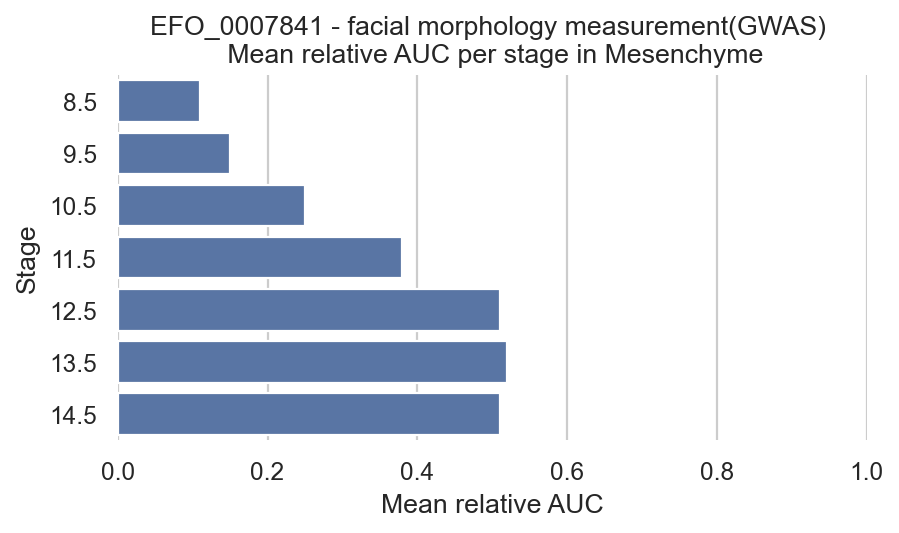

In [127]:
#plot histograms and means and stuff
import numpy as np
adata_tmp = adata[adata.obs['annotation_all'].isin(['Mesenchyme','Neural Crest'])].copy()
means = []
for stage in list(adata_tmp.obs['stage'].cat.categories):
    print(stage+' mean '+str(np.mean(adata_tmp.obs[adata_tmp.obs['stage']==stage]['EFO_0007841_0.1 - facial morphology measurement(GWAS)_aucell_norm'])))
    means = means + [np.mean(adata_tmp.obs[adata_tmp.obs['stage']==stage]['EFO_0007841_0.1 - facial morphology measurement(GWAS)_aucell_norm'])]

means = [round(elem, 2) for elem in means ]

import seaborn as sns
from matplotlib import pyplot as plt
f, ax = plt.subplots(figsize=(6, 3))
sns.set_theme(style="whitegrid")
ax = sns.barplot(y=['8.5','9.5','10.5','11.5','12.5','13.5','14.5'], x=means)
sns.despine(left=True, bottom=True)
plt.xlabel('Mean relative AUC')
plt.ylabel('Stage')
plt.title('EFO_0007841 - facial morphology measurement(GWAS) \n Mean relative AUC per stage in Mesenchyme')
#ax.bar_label(ax.containers[0])
plt.xlim(0, 1)
plt.savefig("figures/GWAS_aucell/barplot_mesen_facial_morphology_measurement_xmax_hvg.svg",bbox_inches = "tight")

plt.show()

8 mean 0.09402176913966752
9 mean 0.1576520781723094
10 mean 0.22399863191123864
11 mean 0.2916643245640749
12 mean 0.3809443113764422
13 mean 0.3890670871075537
14 mean 0.4029585276249854


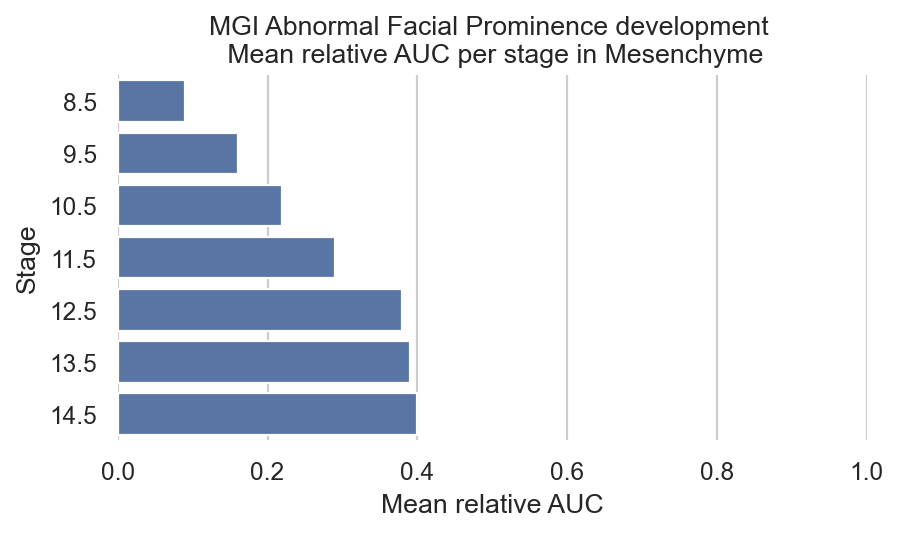

In [128]:
#plot histograms and means and stuff
import numpy as np
adata_tmp = adata[adata.obs['annotation_all'].isin(['Mesenchyme','Neural Crest'])].copy()
means = []
for stage in list(adata_tmp.obs['stage'].cat.categories):
    print(stage+' mean '+str(np.mean(adata_tmp.obs[adata_tmp.obs['stage']==stage]['prominences_aucell_norm'])))
    means = means + [np.mean(adata_tmp.obs[adata_tmp.obs['stage']==stage]['prominences_aucell_norm'])]

means = [round(elem, 2) for elem in means ]

import seaborn as sns
from matplotlib import pyplot as plt
f, ax = plt.subplots(figsize=(6, 3))
sns.set_theme(style="whitegrid")
ax = sns.barplot(y=['8.5','9.5','10.5','11.5','12.5','13.5','14.5'], x=means)
sns.despine(left=True, bottom=True)
plt.xlabel('Mean relative AUC')
plt.ylabel('Stage')
plt.title('MGI Abnormal Facial Prominence development \n Mean relative AUC per stage in Mesenchyme')
#ax.bar_label(ax.containers[0])
plt.xlim(0, 1)
plt.savefig("figures/GWAS_aucell/barplot_prominence_xmax_hvg.svg",bbox_inches = "tight")

plt.show()

8 mean 0.1340568462912821
9 mean 0.16055128840744717
10 mean 0.2609241774995256
11 mean 0.365055407414335
12 mean 0.42488434064402303
13 mean 0.46663703934283307
14 mean 0.5095958026728206


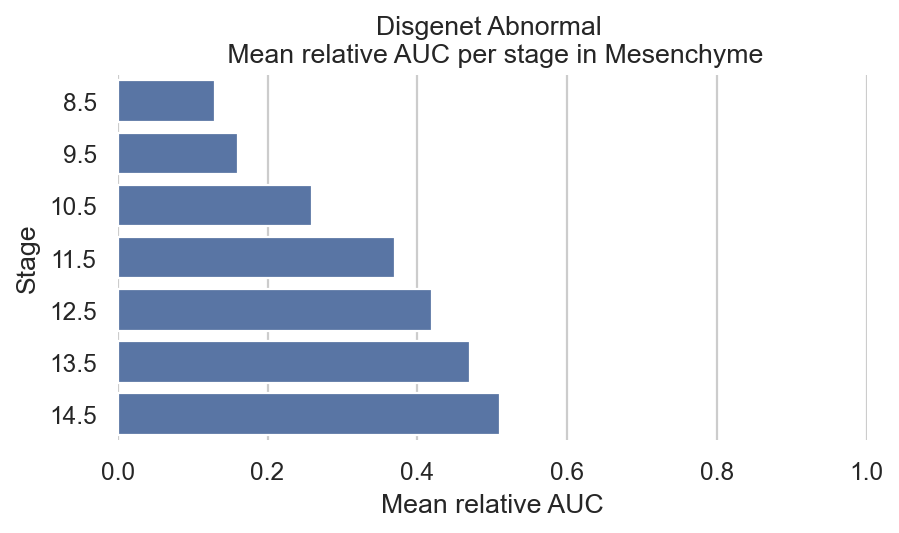

In [129]:
#plot histograms and means and stuff
import numpy as np
adata_tmp = adata[adata.obs['annotation_all'].isin(['Mesenchyme','Neural Crest'])].copy()
means = []
for stage in list(adata_tmp.obs['stage'].cat.categories):
    print(stage+' mean '+str(np.mean(adata_tmp.obs[adata_tmp.obs['stage']==stage]['disgenet_cleft_aucell_norm'])))
    means = means + [np.mean(adata_tmp.obs[adata_tmp.obs['stage']==stage]['disgenet_cleft_aucell_norm'])]

means = [round(elem, 2) for elem in means ]

import seaborn as sns
from matplotlib import pyplot as plt
f, ax = plt.subplots(figsize=(6, 3))
sns.set_theme(style="whitegrid")
ax = sns.barplot(y=['8.5','9.5','10.5','11.5','12.5','13.5','14.5'], x=means)
sns.despine(left=True, bottom=True)
plt.xlabel('Mean relative AUC')
plt.ylabel('Stage')
plt.title('Disgenet Abnormal \n Mean relative AUC per stage in Mesenchyme')
#ax.bar_label(ax.containers[0])
plt.xlim(0, 1)
plt.savefig("figures/GWAS_aucell/barplot_disgenet_xmax_hvg.svg",bbox_inches = "tight")

plt.show()

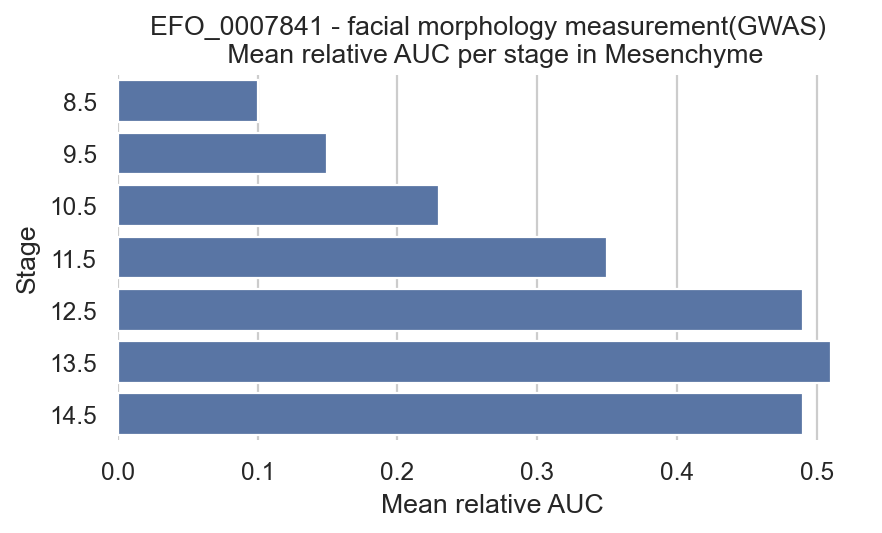

In [67]:
import seaborn as sns
from matplotlib import pyplot as plt
f, ax = plt.subplots(figsize=(6, 3))
sns.set_theme(style="whitegrid")
ax = sns.barplot(y=['8.5','9.5','10.5','11.5','12.5','13.5','14.5'], x=means)
sns.despine(left=True, bottom=True)
plt.xlabel('Mean relative AUC')
plt.ylabel('Stage')
plt.title('EFO_0007841 - facial morphology measurement(GWAS) \n Mean relative AUC per stage in Mesenchyme')
#ax.bar_label(ax.containers[0])
#plt.xlim(0, 1)
plt.savefig("figures/GWAS_aucell/barplot_mesen_facial_morphology_measurement_hvg.svg",bbox_inches = "tight")
plt.show()


In [5]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10,6))
plt.hist(adata.obs['MONDO_0019548 - autosomal dominant intermediate Charcot-Marie-Tooth disease_aucell'], 
                       bins = 50,)
fig, ax = plt.subplots()
ax.set_ylim(1000)
plt.show()

Index
AAACCCAGTAGGATAT.14         Mesenchyme
AAACGAACAAGGCTTT.14         Mesenchyme
AAACGAACAGACCTAT.14         Mesenchyme
AAACGAACAGAGGAAA.14         Mesenchyme
AAACGAAGTCCTATAG.14             Muscle
                               ...    
TTTCAGTGGACACT.E10_10x72    Mesenchyme
TTTCAGTGTCTTAC.E10_10x72         Brain
TTTCCAGAAAAACG.E10_10x72         Brain
TTTCCAGAATGTCG.E10_10x72         Brain
TTTGACTGCAGCTA.E10_10x72         Brain
Name: annotation_all, Length: 58973, dtype: category
Categories (9, object): ['Brain', 'Ectoderm', 'Endothelium', 'Glia', ..., 'Mesenchyme', 'Mesoderm', 'Muscle', 'Neural Crest']

In [ ]:
##Assest more than one geneset
geneset_names=list(gene_set_dict.keys())
ov.single.pathway_aucell(adata,
                            pathway_names=geneset_names,
                            pathways_dict=gene_set_dict)


sc.pl.embedding(adata,
                basis='umap',
                color=['annotation_all']+[i+'_aucell' for i in geneset_names],
                ncols = 2)

In [ ]:
from pathlib import Path

save_loc = './figures/GWAS_aucell'
sc._settings.ScanpyConfig.figdir=Path(save_loc) #set figdir
sc.set_figure_params(figsize=[10,7])

import matplotlib.pyplot as plt
plt.rcParams['svg.fonttype'] = 'none'

for disease in [i+'_aucell' for i in geneset_names]:
    sc.pl.embedding(adata,
                basis='umap',
                color=[disease],
                ncols = 1,size = 15, cmap = 'bwr',vmin = 0, vmax = 0.15,save = 'vmax_aucell_'+disease+'.svg')

In [ ]:
sc.pl.embedding(adata,
                basis='umap',
                color=['annotation_all']+[i+'_aucell' for i in geneset_names],
                cmap = 'plasma',
                ncols = 2, vmax = 0.16, vmin = 0)

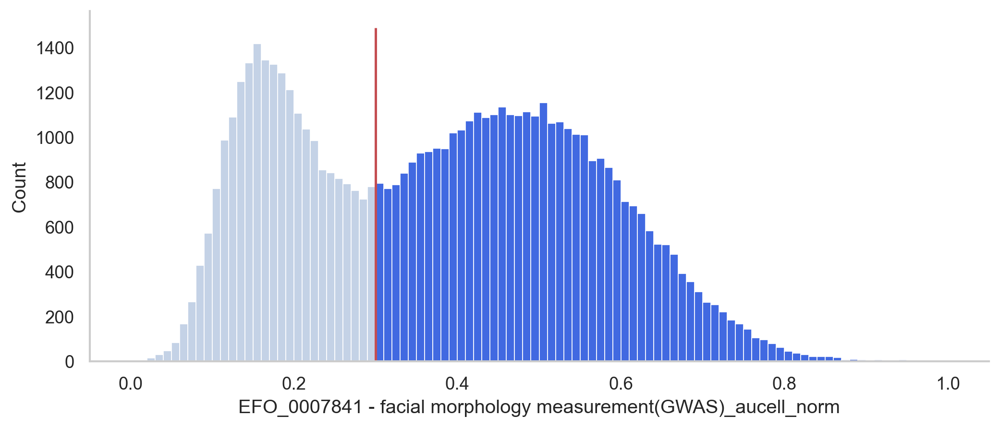

In [68]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle

# plt parameters
plt.rcParams['figure.figsize'] = (10.0, 4)
plt.style.use('seaborn-dark-palette')
plt.rcParams['axes.grid'] = True
plt.rcParams["patch.force_edgecolor"] = True
sns.set_style("whitegrid", {'axes.grid' : False})
# data
replicates = adata.obs['EFO_0007841 - facial morphology measurement(GWAS)_aucell_norm']

mean_diff = .3

# plot replicates
p = sns.histplot(replicates, bins=100, color = 'lightsteelblue')
ymin,ymax = p.get_ylim()
sns.despine(top=True)

# add the vertical line
plt.vlines(mean_diff, ymin, ymax, color='r', label='mean', colors="r")


# color bars greater than mean_diff except the partial bar
for rectangle in p.patches:
    if rectangle.get_x() >= mean_diff:
        rectangle.set_facecolor('royalblue')

plt.savefig("figures/GWAS_aucell/histplot_facial_morphology_all_cells.svg",bbox_inches = "tight")

plt.show()

In [338]:
s = adata[adata_mesen.obs.index].obs.loc[:,['EFO_0007841_aucell', 'random_1_aucell', 'EFO_0007841 - facial morphology measurement(GWAS)_aucell', 
                                        'EFO_0007843 - nose morphology measurement(GWAS)_aucell', 'EFO_1000720 - keratosis_aucell', 'EFO_0005917 - generalised epilepsy_aucell', 
                                        'EFO_0005410 - tooth agenesis_aucell', 'EFO_0000540 - immune system disease_aucell', 
                                        'MONDO_0019548 - autosomal dominant intermediate Charcot-Marie-Tooth disease_aucell', 'random_2_aucell', 
                                        'EFO_0010642 - neurodevelopmental disorder_aucell', 'EFO_0004875 - mathematical ability_aucell', 
                                        'EFO_0007841 - facial morphology measurement(GWAS)_aucell_norm', 'EFO_0007843 - nose morphology measurement(GWAS)_aucell_norm', 
                                        'EFO_1000720 - keratosis_aucell_norm', 'EFO_0005917 - generalised epilepsy_aucell_norm', 'EFO_0005410 - tooth agenesis_aucell_norm', 
                                        'EFO_0000540 - immune system disease_aucell_norm', 'MONDO_0019548 - autosomal dominant intermediate Charcot-Marie-Tooth disease_aucell_norm', 
                                        'EFO_0010642 - neurodevelopmental disorder_aucell_norm', 'EFO_0004875 - mathematical ability_aucell_norm', 'random_1_aucell_norm', 
                                        'random_2_aucell_norm', 'MP:0002233 - abnormal nose morphology_aucell', 'MP:0003935 - abnormal craniofacial development_aucell', 
                                        'MP:0003743 - abnormal facial morphology_aucell', 'MP:0011495 - abnormal head shape_aucell', 'MP:0002233 - abnormal nose morphology_aucell_norm', 
                                        'MP:0003935 - abnormal craniofacial development_aucell_norm', 'MP:0003743 - abnormal facial morphology_aucell_norm', 
                                        'MP:0011495 - abnormal head shape_aucell_norm', 'MP:0021164 - oral cleft_aucell', 'MP:0021164 - oral cleft_aucell_norm', 
                                        'MP:0009901 - abnormal frontonasal prominence morphology_aucell', 'MP:0009902 - abnormal lateral nasal prominence morphology_aucell', 
                                        'MP:0010940 - abnormal maxillary prominence morphology_aucell', 'MP:0009901 - abnormal frontonasal prominence morphology_aucell_norm', 
                                        'MP:0009902 - abnormal lateral nasal prominence morphology_aucell_norm', 'MP:0010940 - abnormal maxillary prominence morphology_aucell_norm', 
                                        'MP:0009903 - abnormal medial nasal prominence morphology_aucell', 'prominences_aucell', 
                                        'MP:0009903 - abnormal medial nasal prominence morphology_aucell_norm', 'prominences_aucell_norm', 'siewert_nsCL_P_aucell', 'siewert_syCL_P_aucell', 
                                        'siewert_CL_P_aucell', 'siewert_nsCL_P_aucell_norm', 'siewert_syCL_P_aucell_norm', 'siewert_CL_P_aucell_norm', 'annotation_all_stage', 
                                        'disgenet_aucell', 'disgenet_aucell_norm']]

adata_mesen.obs = pd.concat([adata_mesen.obs, s], axis=1)

In [344]:
plot_list = [
    'EFO_0007841 - facial morphology measurement(GWAS)_aucell', 'EFO_0007841 - facial morphology measurement(GWAS)_aucell_norm',
    'EFO_0007843 - nose morphology measurement(GWAS)_aucell', 'EFO_0007843 - nose morphology measurement(GWAS)_aucell_norm', 
    'EFO_0005410 - tooth agenesis_aucell', 'EFO_0005410 - tooth agenesis_aucell_norm',
    'random_2_aucell', 'random_2_aucell_norm',
    'MP:0002233 - abnormal nose morphology_aucell', 'MP:0002233 - abnormal nose morphology_aucell_norm', 
    'MP:0003935 - abnormal craniofacial development_aucell', 'MP:0003935 - abnormal craniofacial development_aucell_norm',
    'MP:0003743 - abnormal facial morphology_aucell', 'MP:0003743 - abnormal facial morphology_aucell_norm',
    'MP:0011495 - abnormal head shape_aucell', 'MP:0011495 - abnormal head shape_aucell_norm',
    'MP:0021164 - oral cleft_aucell', 'MP:0021164 - oral cleft_aucell_norm', 
    'MP:0009901 - abnormal frontonasal prominence morphology_aucell', 'MP:0009901 - abnormal frontonasal prominence morphology_aucell_norm', 
    'MP:0009902 - abnormal lateral nasal prominence morphology_aucell', 'MP:0009902 - abnormal lateral nasal prominence morphology_aucell_norm',
    'MP:0010940 - abnormal maxillary prominence morphology_aucell', 'MP:0010940 - abnormal maxillary prominence morphology_aucell_norm', 
    'MP:0009903 - abnormal medial nasal prominence morphology_aucell', 'MP:0009903 - abnormal medial nasal prominence morphology_aucell_norm',
    'prominences_aucell', 'prominences_aucell_norm',
    'siewert_nsCL_P_aucell', 'siewert_nsCL_P_aucell_norm',
    'siewert_syCL_P_aucell', 'siewert_syCL_P_aucell_norm', 
    'siewert_CL_P_aucell', 'siewert_CL_P_aucell_norm', 
    'disgenet_aucell', 'disgenet_aucell_norm'
]

In [ ]:
plt.rcParams['figure.figsize'] = (10.0, 8)
sc.pl.embedding(adata_mesen,
                basis='umap',
                color=plot_list,
                ncols = 2,size = 15, cmap = 'bwr',vmin = 0,)